#  Style Transfer using CycleGAN for MRI Images

### Importing Libraries

In [48]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [103]:
%pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-kgrmwel3
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/docs /tmp/pip-req-build-kgrmwel3
  Resolved https://github.com/tensorflow/docs to commit 97ac0aea73f1cf802004049f92bd3a985010d7e5
  Preparing metadata (setup.py) ... done
  Created wheel for tensorflow-docs: filename=tensorflow_docs-2023.9.4.19335-py3-none-any.whl size=184104 sha256=61e908082ae86299505751d4dd4e32f270f9d2af15674a590bef8b400a8a96a7
  Stored in directory: /tmp/pip-ephem-wheel-cache-sqfh8hbb/wheels/86/0f/1e/3b62293c8ffd0fd5a49508e6871cdb7554abe9c62afd35ec53
Successfully built tensorflow-docs


In [49]:
!unzip /content/MRI+T1_T2+Dataset.zip

Archive:  /content/MRI+T1_T2+Dataset.zip
replace MRI+T1_T2+Dataset/Tr1/.DS_Store? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [50]:
# Library for image processing and visualization
from skimage.transform import resize
from PIL import Image
import imageio
import matplotlib.pyplot as plt
%matplotlib inline

# Library for handling file operations
import os

# Library for handling array operations
import numpy as np

# Library for handling deep learning
import tensorflow as tf
from keras.utils.vis_utils import plot_model

# Library for Miscellaneous tasks
import warnings

warnings.filterwarnings("ignore")

### Data loading and preprocessing

In [51]:
# Path for images in Sample dataset provided
t1 = "/content/MRI+T1_T2+Dataset/Tr1/TrainT1/"
t2 = "/content/MRI+T1_T2+Dataset/Tr2/TrainT2/"

# Image size
img_height = 128
img_width = 128

In [52]:
# list of images
t1_images = [t1 + i for i in os.listdir(t1)]
t2_images = [t2 + i for i in os.listdir(t2)]

In [53]:
# Images count for each category
print("\n\nTotal Images in each category:\n")
print(f"t1: {len(t1_images)}")
print(f"t2: {len(t2_images)}")



Total Images in each category:

t1: 43
t2: 46




Sample Images from each category:



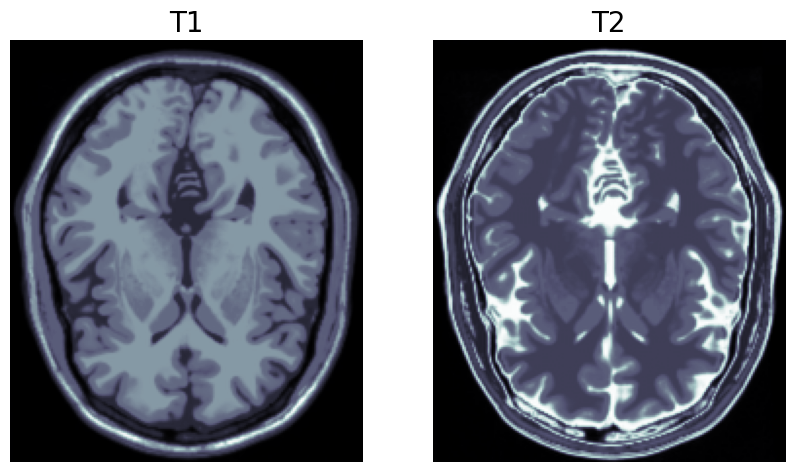

In [54]:
# Priting sample images from each category
print("\n\nSample Images from each category:\n")
plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(plt.imread(t1_images[0]), cmap="bone")
plt.title("T1", fontsize=20)
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(plt.imread(t2_images[0]), cmap="bone")
plt.title("T2", fontsize=20)
plt.axis("off")
plt.show()

In [55]:
# function to load images and resize
def load_images(img_list):
    img_arr = []
    for img in img_list:
        img = Image.open(img)
        img_arr.append(np.array(img))
    return np.array(img_arr)

In [56]:
t1_images = load_images(t1_images)
t2_images = load_images(t2_images)

In [57]:
# information of dataset
print("\n\nInformation of dataset:\n")
print(f"t1: {t1_images.shape}")
print(f"t2: {t2_images.shape}")



Information of dataset:

t1: (43, 217, 181)
t2: (46, 217, 181)


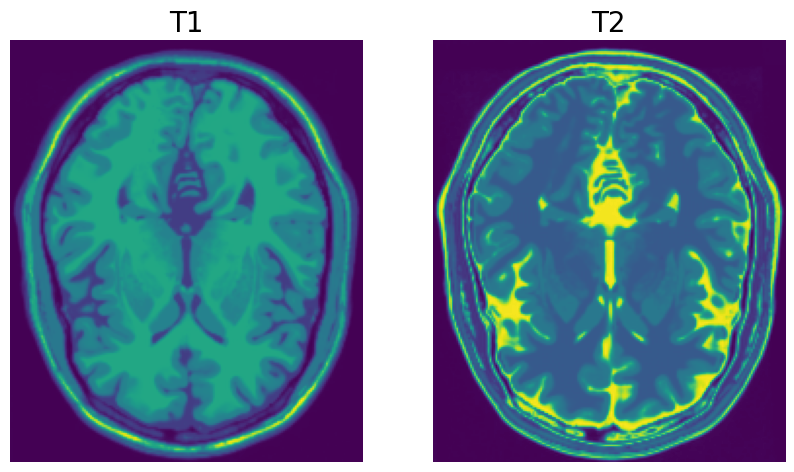

In [59]:
# Printing sample images from each category after preprocessing
plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(t1_images[0])
plt.title("T1", fontsize=20)
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(t2_images[0])
plt.title("T2", fontsize=20)
plt.axis("off")
plt.show()

In [60]:
# Function to normalize images
def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    return (img / 127.5) - 1.0

In [61]:
# Function to preprocess images
def preprocess_images(img):
    img = tf.image.random_flip_left_right(img)
    img = tf.image.resize(img, [*(img_height, img_width)])
    img = tf.image.random_crop(img, size=[*(img_height, img_width, 1)])
    img = normalize_img(img)
    return img

In [62]:
# reshaping array to format (height, width, channels) with channels = 1
t1_images = t1_images.reshape(
    t1_images.shape[0], t1_images.shape[1], t1_images.shape[2], 1
).astype("float32")
t2_images = t2_images.reshape(
    t2_images.shape[0], t2_images.shape[1], t2_images.shape[2], 1
).astype("float32")

In [63]:
# Daataset augmentation
data_augmentation = tf.keras.Sequential([tf.keras.layers.RandomFlip("horizontal")])
t1_images = np.concatenate([data_augmentation(t1_images), t1_images], axis=0)
t2_images = np.concatenate([data_augmentation(t2_images), t2_images], axis=0)

In [64]:
t1_images = [preprocess_images(image) for image in t1_images]
t2_images = [preprocess_images(image) for image in t2_images]

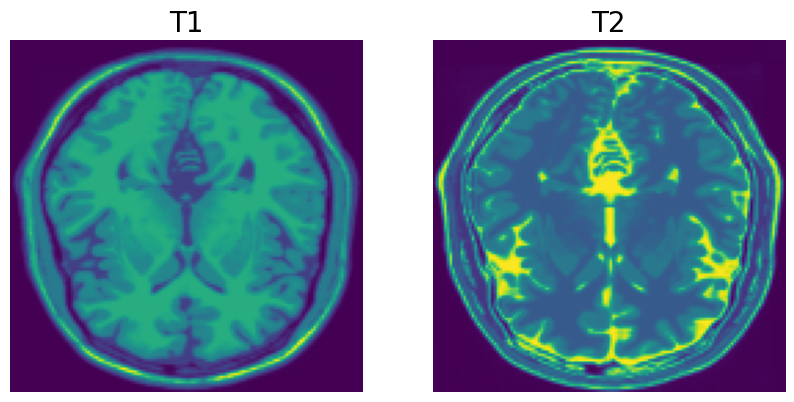

In [65]:
# Printing sample images from each category after preprocessing
plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(t1_images[0])
plt.title("T1", fontsize=20)
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(t2_images[0])
plt.title("T2", fontsize=20)
plt.axis("off")
plt.show()

### Data Batch Creation

In [66]:
# defining batch and buffer size
buffer_size = 256
batch_size = 1

In [67]:
t1_images = (
    tf.data.Dataset.from_tensor_slices(t1_images)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
t2_images = (
    tf.data.Dataset.from_tensor_slices(t2_images)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

### Creating Generator and Discriminator

In [68]:
# Weights initializer for the layers.
kernel_init = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# Gamma initializer for instance normalization.
gamma_init = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

In [70]:
# Instance Normalization

class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon

    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)

    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

In [71]:
# Downsampling method
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0.0, 0.02)
    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2D(
            filters,
            size,
            strides=2,
            padding="same",
            kernel_initializer=initializer,
            use_bias=False,
        )
    )
    if apply_norm:
        result.add(InstanceNormalization())
    result.add(tf.keras.layers.LeakyReLU())
    return result

In [72]:
# Upsampling method
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0.0, 0.02)
    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2DTranspose(
            filters,
            size,
            strides=2,
            padding="same",
            kernel_initializer=initializer,
            use_bias=False,
        )
    )
    result.add(InstanceNormalization())
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    result.add(tf.keras.layers.ReLU())
    return result

In [73]:
def unet_generator():
    down_stack = [
        downsample(128, 4, apply_norm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
    ]
    # create a stack of downsample models
    up_stack = [
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4),
        upsample(256, 4),
        upsample(128, 4),
        upsample(128, 4),
    ]  # create a stack of upsample models

    initializer = tf.random_normal_initializer(0.0, 0.02)
    last = tf.keras.layers.Conv2DTranspose(
        1,
        4,
        strides=2,
        padding="same",
        kernel_initializer=initializer,
        activation="tanh",
    )
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

In [74]:
# Creating generator models
generator_g = unet_generator()
generator_f = unet_generator()

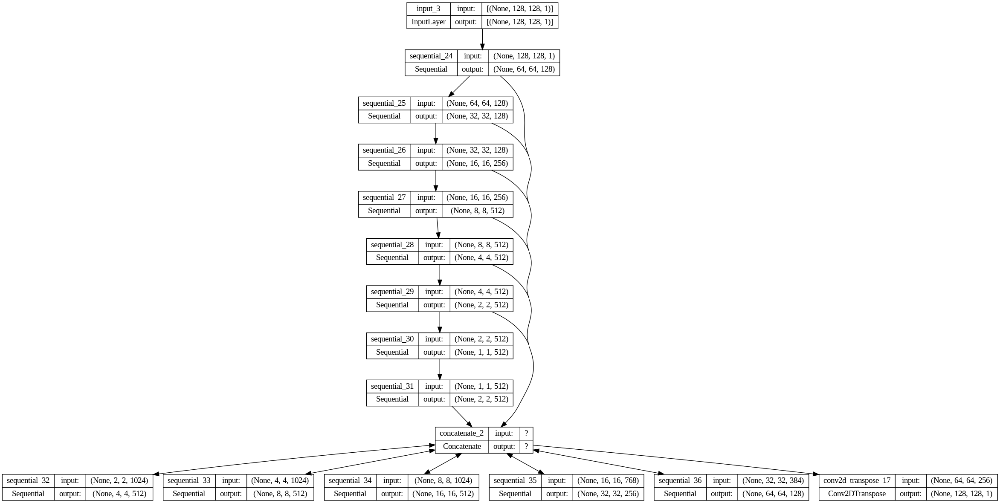

In [75]:
# Printing summary of generator g
plot_model(generator_g, show_shapes=True)

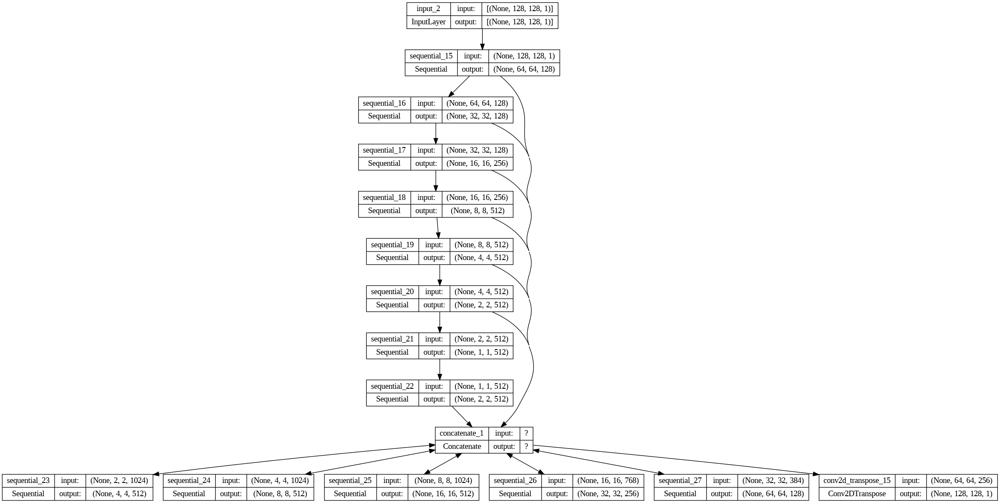

In [ ]:
# Printing summary of generator f
plot_model(generator_f, show_shapes=True)

In [79]:
# function for discriminator
def discriminator():
    in_image = tf.keras.layers.Input(shape=[128, 128, 1], name="input_image")
    d = tf.keras.layers.Conv2D(
        64, (4, 4), strides=(2, 2), padding="same", kernel_initializer=kernel_init
    )(in_image)
    d = tf.keras.layers.LeakyReLU(alpha=0.2)(d)
    d = tf.keras.layers.Conv2D(
        128, (4, 4), strides=(2, 2), padding="same", kernel_initializer=kernel_init
    )(d)
    d = InstanceNormalization()(d)
    d = tf.keras.layers.LeakyReLU(alpha=0.2)(d)
    d = tf.keras.layers.Conv2D(
        256, (4, 4), strides=(2, 2), padding="same", kernel_initializer=kernel_init
    )(d)
    d = InstanceNormalization()(d)
    d = tf.keras.layers.LeakyReLU(alpha=0.2)(d)
    d = tf.keras.layers.Conv2D(
        512, (4, 4), strides=(2, 2), padding="same", kernel_initializer=kernel_init
    )(d)
    d = InstanceNormalization()(d)
    d = tf.keras.layers.LeakyReLU(alpha=0.2)(d)
    d = tf.keras.layers.Conv2D(
        512, (4, 4), padding="same", kernel_initializer=kernel_init
    )(d)
    d = InstanceNormalization()(d)
    d = tf.keras.layers.LeakyReLU(alpha=0.2)(d)
    patch_out = tf.keras.layers.Conv2D(
        1, (4, 4), padding="same", kernel_initializer=kernel_init
    )(d)
    return tf.keras.models.Model(in_image, patch_out)

In [80]:
# Creating generator models
discriminator_x = discriminator()
discriminator_y = discriminator()

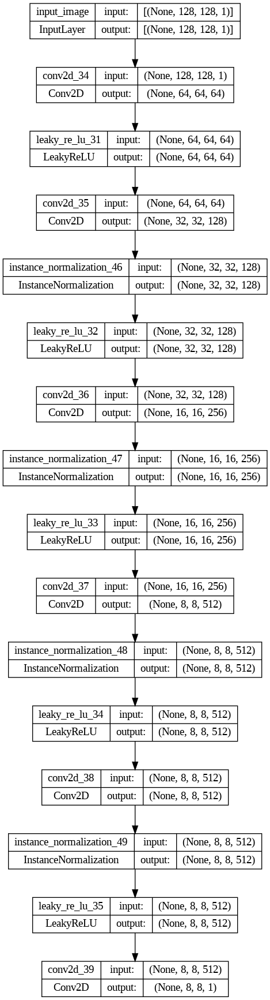

In [81]:
# Printing summary of generator g
plot_model(discriminator_x, show_shapes=True)

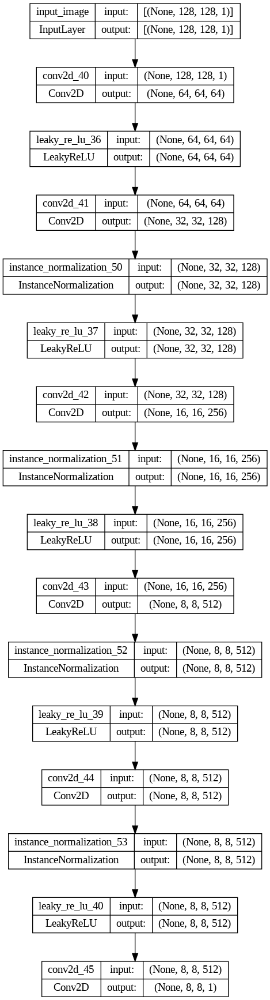

In [83]:
# Printing summary of generator f
plot_model(discriminator_y, show_shapes=True)

### Defining Loss Functions

In [84]:
# Binary cross entropy loss function
bce_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [85]:
# Define the loss function for the generators
def generator_loss(generated):
    return bce_loss(tf.ones_like(generated), generated)

In [86]:
# function for discriminator loss
def discriminator_loss(real, generated):
    real_loss = bce_loss(tf.ones_like(real), real)
    generated_loss = bce_loss(tf.zeros_like(generated), generated)
    return (real_loss + generated_loss) * 0.5

In [87]:
# Cycle consistency loss function
def calc_cycle_loss(real_image, cycled_image):
    return tf.reduce_mean(tf.abs(real_image - cycled_image))

In [88]:
# Identity loss function
def identity_loss(real_image, same_image):
    return tf.reduce_mean(tf.abs(real_image - same_image))

Parameters for Loss Function defined in CycleGAN Model class (10,0.5)

### Defining Optimizers

In [89]:
# Leveraging Adam Optimizer to smoothen gradient descent
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

### CycleGAN Model

In [90]:
class CycleGan(tf.keras.Model):
    def __init__(
        self,
        generator_G,
        generator_F,
        discriminator_X,
        discriminator_Y,
        lambda_cycle=10.0,
        lambda_identity=0.5,
    ):
        super().__init__()
        self.gen_G = generator_G
        self.gen_F = generator_F
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def call(self, inputs):
        return (
            self.disc_X(inputs),
            self.disc_Y(inputs),
            self.gen_G(inputs),
            self.gen_F(inputs),
        )

    def compile(
        self,
        gen_G_optimizer,
        gen_F_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        gen_loss_fn,
        disc_loss_fn,
        cycle_loss_fn,
        identity_loss_fn,
    ):
        super().compile()
        self.gen_G_optimizer = gen_G_optimizer
        self.gen_F_optimizer = gen_F_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn

    def train_step(self, batch_data):
        real_x, real_y = batch_data
        with tf.GradientTape(persistent=True) as tape:
            fake_y = self.gen_G(real_x, training=True)
            fake_x = self.gen_F(real_y, training=True)

            cycled_x = self.gen_F(fake_y, training=True)
            cycled_y = self.gen_G(fake_x, training=True)

            # Identity mapping
            same_x = self.gen_F(real_x, training=True)
            same_y = self.gen_G(real_y, training=True)

            # Discriminator output
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)

            # Generator adversarial loss
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)

            # Generator cycle loss
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle

            # Generator identity loss
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )

            # Total generator loss
            total_loss_G = gen_G_loss + cycle_loss_G + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F + id_loss_F

            # Discriminator loss
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)

        # Get the gradients for the generators
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)

        # Get the gradients for the discriminators
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)

        # Update the weights of the generators
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )

        # Update the weights of the discriminators
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )

        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
            "Total_Generator_Loss": total_loss_G+total_loss_F,
        }

### CallBacks defined

In [91]:
# Getting Sample Image
t1_sample = t1_images.shuffle(buffer_size).as_numpy_iterator().next()
t2_sample = t2_images.shuffle(buffer_size).as_numpy_iterator().next()


class GANMonitor(tf.keras.callbacks.Callback):
    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_train_begin(self, epoch, logs=None):
        prediction1 = self.model.gen_G.predict(t1_sample)
        prediction2 = self.model.gen_F.predict(t2_sample)
        fig = plt.figure(figsize=(8, 4))
        display_list = [t1_sample[0], prediction1[0], t2_sample[0], prediction2[0]]
        title = ["Input Image", "Generated Image", "Input Image", "Generated Image"]
        for i in range(4):
            plt.subplot(1, 4, i + 1)
            plt.title(title[i])
            plt.imshow(display_list[i][:, :, 0], cmap="gray")
            plt.axis("off")
        fig.suptitle("CycleGAN Sample Output Before Training", fontsize=16)
        plt.savefig("IMG/image_at_epoch_0.png")
        plt.show()
        plt.close()

    def on_epoch_end(self, epoch, logs=None):
        prediction1 = self.model.gen_G.predict(t1_sample)
        prediction2 = self.model.gen_F.predict(t2_sample)
        fig = plt.figure(figsize=(8, 4))
        display_list = [t1_sample[0], prediction1[0], t2_sample[0], prediction2[0]]
        title = ["Input Image", "Generated Image", "Input Image", "Generated Image"]
        for i in range(4):
            plt.subplot(1, 4, i + 1)
            plt.title(title[i])
            plt.imshow(display_list[i][:, :, 0], cmap="gray")
            plt.axis("off")
        fig.suptitle(f"CycleGAN Sample Output After epoch {epoch+1}", fontsize=16)
        plt.savefig(f"IMG/image_at_epoch_{epoch+1}.png")
        plt.show()
        plt.close()

In [92]:
# Checkpoint callback
checkpoint_filepath = (
    "./checkpoints"
)
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    monitor="Total_Generator_Loss",filepath=checkpoint_filepath, save_weights_only=True, save_freq="epoch",save_best_only=True
)

### Model Training

In [93]:
# Defining epochs
epochs = 100

In [94]:
# create a CycleGAN model
cycle_gan_model = CycleGan(
    generator_F=generator_f,
    generator_G=generator_g,
    discriminator_X=discriminator_x,
    discriminator_Y=discriminator_y,
)

In [95]:
# compile the model
cycle_gan_model.compile(
    gen_G_optimizer=generator_g_optimizer,
    gen_F_optimizer=generator_f_optimizer,
    disc_X_optimizer=discriminator_x_optimizer,
    disc_Y_optimizer=discriminator_y_optimizer,
    gen_loss_fn=generator_loss,
    disc_loss_fn=discriminator_loss,
    cycle_loss_fn=calc_cycle_loss,
    identity_loss_fn=identity_loss,
)

In [96]:
# Callbacks
plotter = GANMonitor()

In [97]:
# Define the directory where generated images will be saved
output_directory = 'IMG'  # You can change this to your desired directory

# Create the directory if it doesn't exist
os.makedirs(output_directory, exist_ok=True)

1/1 [==============================] - 0s 366ms/step


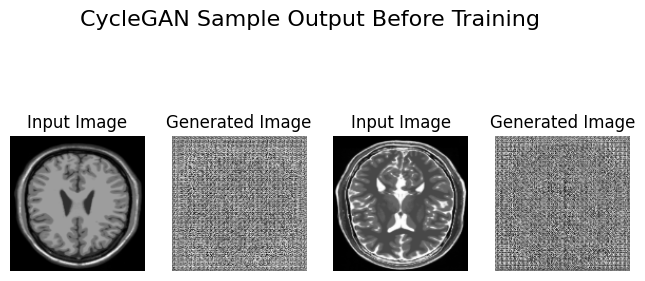

Epoch 1/100
1/1 [==============================] - 0s 147ms/step


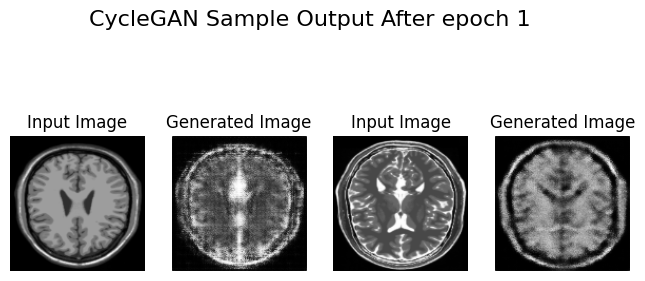

86/86 [==============================] - 78s 353ms/step - G_loss: 4.8057 - F_loss: 3.6982 - D_X_loss: 0.6424 - D_Y_loss: 0.6272 - Total_Generator_Loss: 8.5039
Epoch 2/100
1/1 [==============================] - 0s 22ms/step


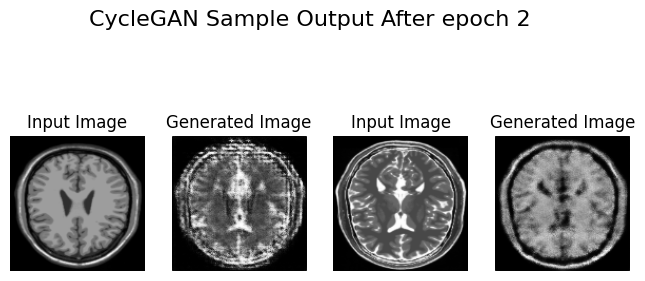

86/86 [==============================] - 29s 342ms/step - G_loss: 3.9407 - F_loss: 2.6723 - D_X_loss: 0.6412 - D_Y_loss: 0.5626 - Total_Generator_Loss: 6.6131
Epoch 3/100
1/1 [==============================] - 0s 19ms/step


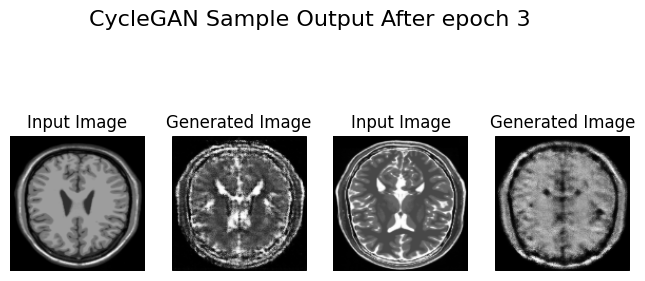

86/86 [==============================] - 30s 344ms/step - G_loss: 3.6733 - F_loss: 2.5701 - D_X_loss: 0.6086 - D_Y_loss: 0.5651 - Total_Generator_Loss: 6.2434
Epoch 4/100
1/1 [==============================] - 0s 21ms/step


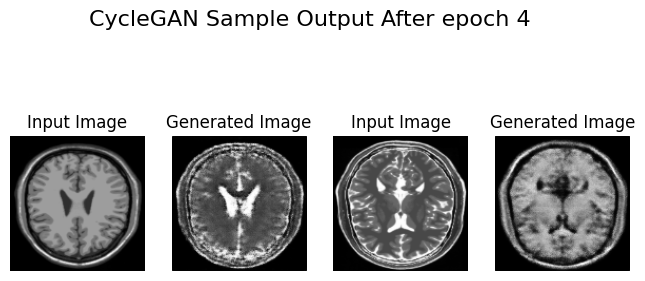

86/86 [==============================] - 30s 348ms/step - G_loss: 3.1900 - F_loss: 2.3389 - D_X_loss: 0.6469 - D_Y_loss: 0.6058 - Total_Generator_Loss: 5.5289
Epoch 5/100
1/1 [==============================] - 0s 30ms/step


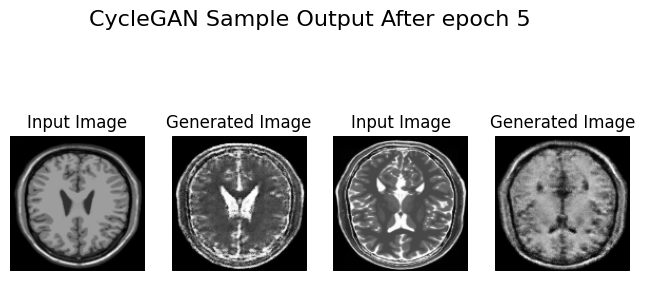

86/86 [==============================] - 30s 353ms/step - G_loss: 3.0241 - F_loss: 2.1920 - D_X_loss: 0.6449 - D_Y_loss: 0.5737 - Total_Generator_Loss: 5.2161
Epoch 6/100
1/1 [==============================] - 0s 29ms/step


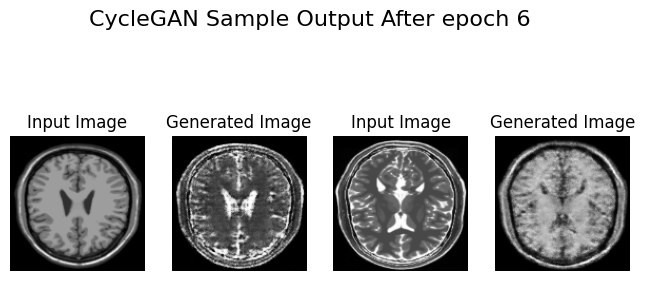

86/86 [==============================] - 31s 356ms/step - G_loss: 2.9286 - F_loss: 2.0655 - D_X_loss: 0.6758 - D_Y_loss: 0.5834 - Total_Generator_Loss: 4.9942
Epoch 7/100
1/1 [==============================] - 0s 36ms/step


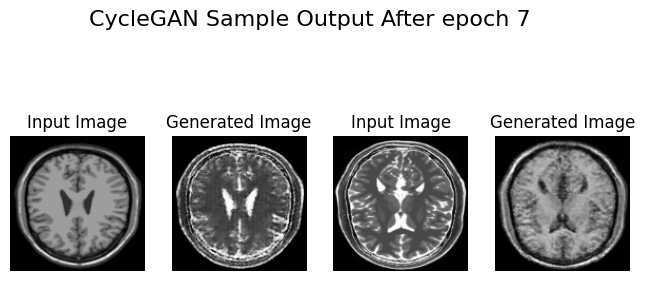

86/86 [==============================] - 31s 355ms/step - G_loss: 2.8423 - F_loss: 1.9846 - D_X_loss: 0.6523 - D_Y_loss: 0.5587 - Total_Generator_Loss: 4.8269
Epoch 8/100
1/1 [==============================] - 0s 19ms/step


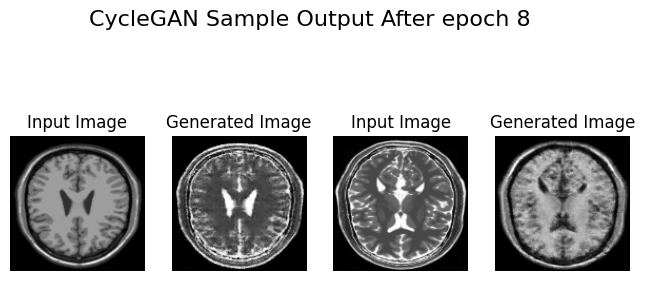

86/86 [==============================] - 30s 354ms/step - G_loss: 2.7189 - F_loss: 1.8754 - D_X_loss: 0.6731 - D_Y_loss: 0.5834 - Total_Generator_Loss: 4.5943
Epoch 9/100
1/1 [==============================] - 0s 20ms/step


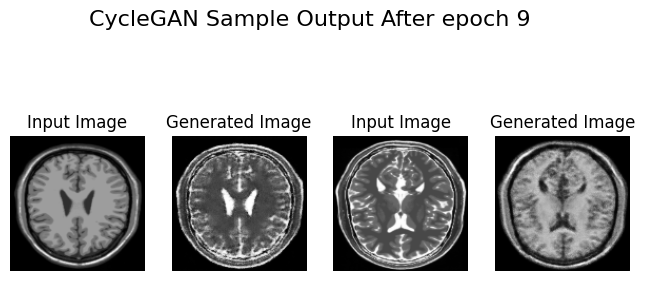

86/86 [==============================] - 31s 356ms/step - G_loss: 2.5046 - F_loss: 1.7461 - D_X_loss: 0.7027 - D_Y_loss: 0.6349 - Total_Generator_Loss: 4.2507
Epoch 10/100
1/1 [==============================] - 0s 21ms/step


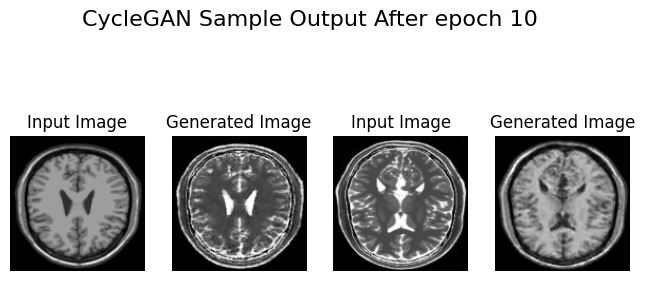

86/86 [==============================] - 31s 356ms/step - G_loss: 2.2493 - F_loss: 1.5785 - D_X_loss: 0.7085 - D_Y_loss: 0.6521 - Total_Generator_Loss: 3.8278
Epoch 11/100
1/1 [==============================] - 0s 19ms/step


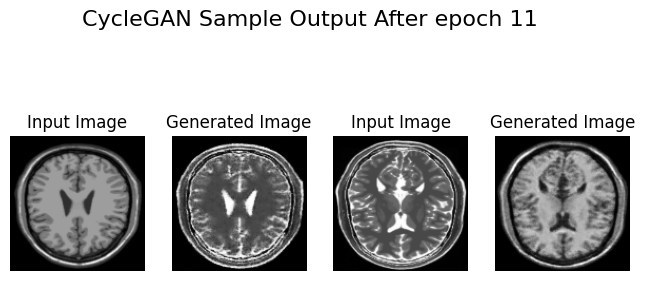

86/86 [==============================] - 31s 355ms/step - G_loss: 2.1400 - F_loss: 1.4892 - D_X_loss: 0.7152 - D_Y_loss: 0.6651 - Total_Generator_Loss: 3.6292
Epoch 12/100
1/1 [==============================] - 0s 34ms/step


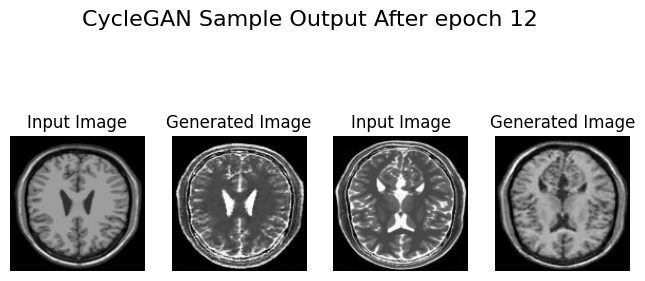

86/86 [==============================] - 31s 360ms/step - G_loss: 1.9487 - F_loss: 1.3769 - D_X_loss: 0.7174 - D_Y_loss: 0.6765 - Total_Generator_Loss: 3.3256
Epoch 13/100
1/1 [==============================] - 0s 32ms/step


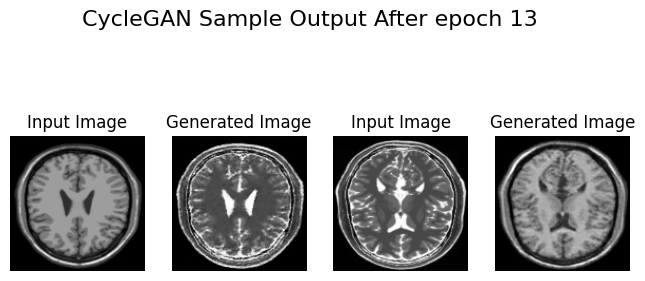

86/86 [==============================] - 31s 358ms/step - G_loss: 1.9187 - F_loss: 1.3570 - D_X_loss: 0.7026 - D_Y_loss: 0.6592 - Total_Generator_Loss: 3.2758
Epoch 14/100
1/1 [==============================] - 0s 20ms/step


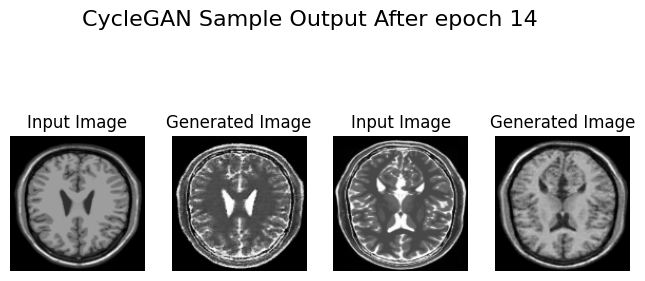

86/86 [==============================] - 31s 356ms/step - G_loss: 1.8568 - F_loss: 1.3307 - D_X_loss: 0.7010 - D_Y_loss: 0.6652 - Total_Generator_Loss: 3.1875
Epoch 15/100
1/1 [==============================] - 0s 28ms/step


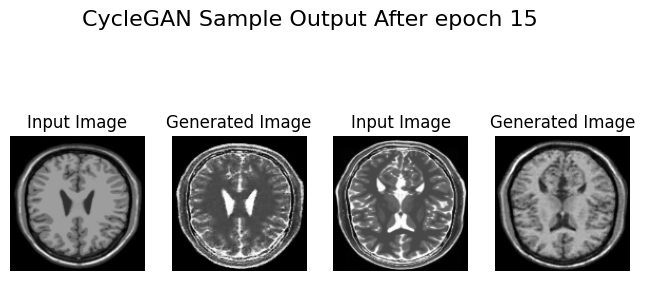

86/86 [==============================] - 31s 359ms/step - G_loss: 1.7899 - F_loss: 1.3199 - D_X_loss: 0.7080 - D_Y_loss: 0.6901 - Total_Generator_Loss: 3.1097
Epoch 16/100
1/1 [==============================] - 0s 24ms/step


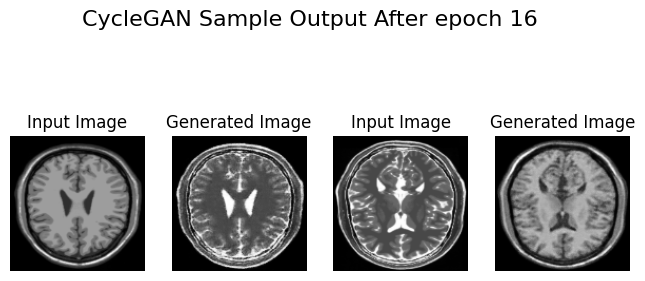

86/86 [==============================] - 31s 358ms/step - G_loss: 1.6773 - F_loss: 1.2676 - D_X_loss: 0.7067 - D_Y_loss: 0.6927 - Total_Generator_Loss: 2.9448
Epoch 17/100
1/1 [==============================] - 0s 23ms/step


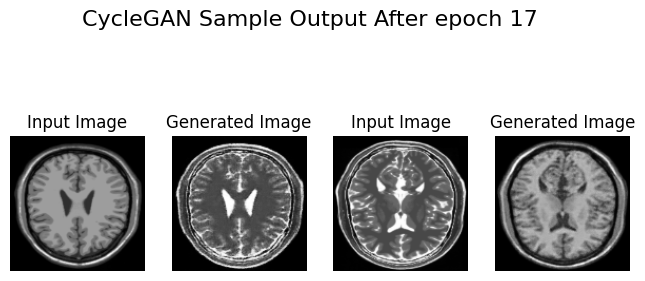

86/86 [==============================] - 31s 358ms/step - G_loss: 1.6154 - F_loss: 1.2189 - D_X_loss: 0.7026 - D_Y_loss: 0.6868 - Total_Generator_Loss: 2.8343
Epoch 18/100
1/1 [==============================] - 0s 38ms/step


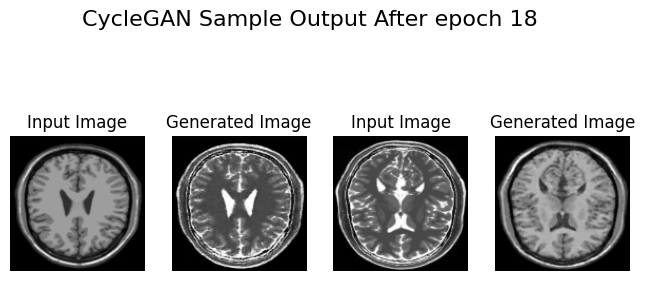

86/86 [==============================] - 31s 361ms/step - G_loss: 1.6053 - F_loss: 1.2217 - D_X_loss: 0.7038 - D_Y_loss: 0.6882 - Total_Generator_Loss: 2.8271
Epoch 19/100
1/1 [==============================] - 0s 25ms/step


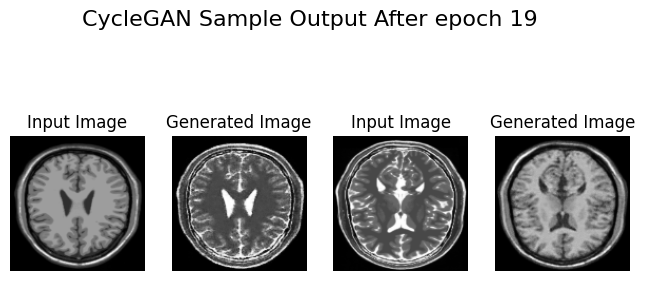

86/86 [==============================] - 31s 359ms/step - G_loss: 1.5673 - F_loss: 1.1978 - D_X_loss: 0.6949 - D_Y_loss: 0.6689 - Total_Generator_Loss: 2.7651
Epoch 20/100
1/1 [==============================] - 0s 24ms/step


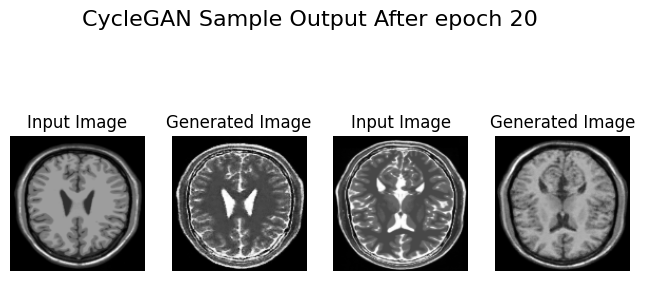

86/86 [==============================] - 31s 356ms/step - G_loss: 1.5431 - F_loss: 1.1799 - D_X_loss: 0.7055 - D_Y_loss: 0.6862 - Total_Generator_Loss: 2.7229
Epoch 21/100
1/1 [==============================] - 0s 28ms/step


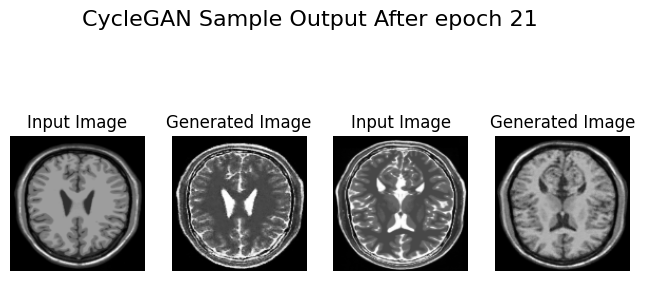

86/86 [==============================] - 31s 356ms/step - G_loss: 1.4745 - F_loss: 1.1490 - D_X_loss: 0.6982 - D_Y_loss: 0.6854 - Total_Generator_Loss: 2.6234
Epoch 22/100
1/1 [==============================] - 0s 26ms/step


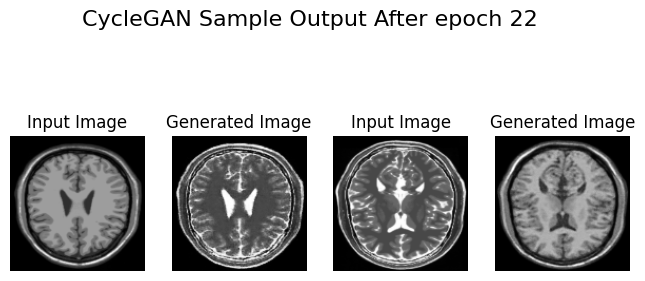

86/86 [==============================] - 31s 362ms/step - G_loss: 1.4733 - F_loss: 1.1527 - D_X_loss: 0.6993 - D_Y_loss: 0.6852 - Total_Generator_Loss: 2.6260
Epoch 23/100
1/1 [==============================] - 0s 28ms/step


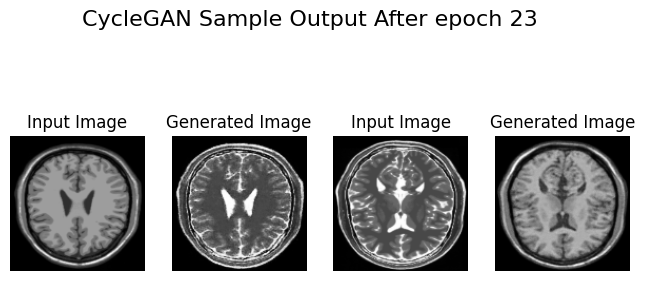

86/86 [==============================] - 31s 356ms/step - G_loss: 1.4379 - F_loss: 1.1137 - D_X_loss: 0.7000 - D_Y_loss: 0.6837 - Total_Generator_Loss: 2.5515
Epoch 24/100
1/1 [==============================] - 0s 32ms/step


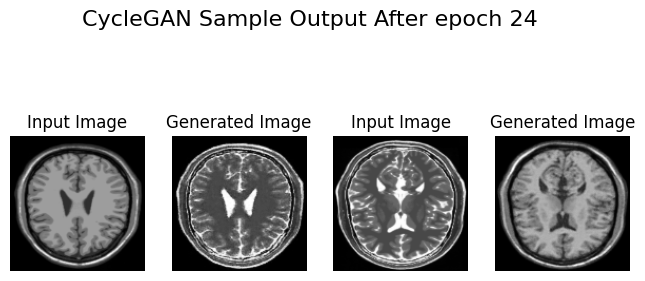

86/86 [==============================] - 31s 356ms/step - G_loss: 1.4626 - F_loss: 1.1474 - D_X_loss: 0.6938 - D_Y_loss: 0.6775 - Total_Generator_Loss: 2.6100
Epoch 25/100
1/1 [==============================] - 0s 45ms/step


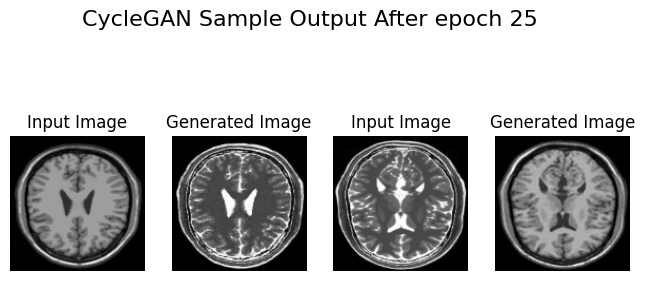

86/86 [==============================] - 31s 361ms/step - G_loss: 1.3677 - F_loss: 1.0862 - D_X_loss: 0.7018 - D_Y_loss: 0.6956 - Total_Generator_Loss: 2.4539
Epoch 26/100
1/1 [==============================] - 0s 60ms/step


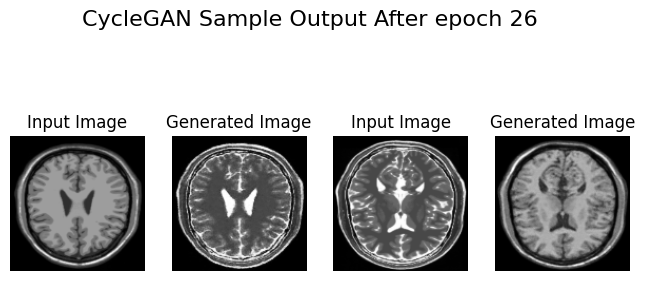

86/86 [==============================] - 31s 361ms/step - G_loss: 1.3663 - F_loss: 1.0949 - D_X_loss: 0.6973 - D_Y_loss: 0.6880 - Total_Generator_Loss: 2.4612
Epoch 27/100
1/1 [==============================] - 0s 44ms/step


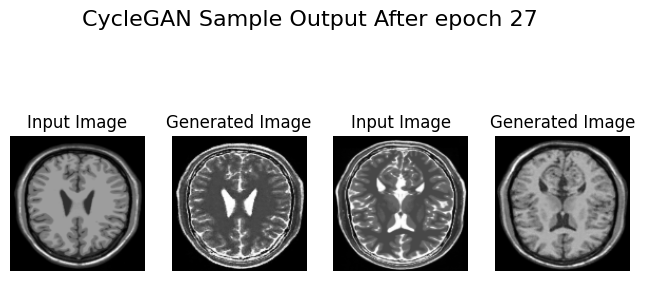

86/86 [==============================] - 31s 359ms/step - G_loss: 1.3365 - F_loss: 1.0974 - D_X_loss: 0.6934 - D_Y_loss: 0.6894 - Total_Generator_Loss: 2.4339
Epoch 28/100
1/1 [==============================] - 0s 32ms/step


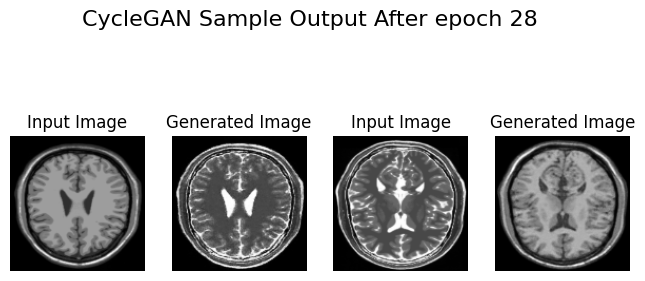

86/86 [==============================] - 31s 357ms/step - G_loss: 1.3351 - F_loss: 1.0837 - D_X_loss: 0.6995 - D_Y_loss: 0.6895 - Total_Generator_Loss: 2.4188
Epoch 29/100
1/1 [==============================] - 0s 31ms/step


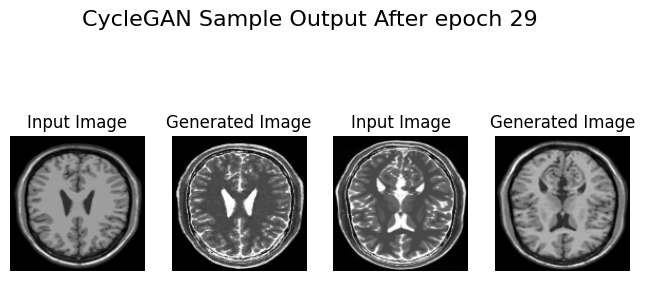

86/86 [==============================] - 31s 357ms/step - G_loss: 1.3203 - F_loss: 1.0974 - D_X_loss: 0.6947 - D_Y_loss: 0.6927 - Total_Generator_Loss: 2.4177
Epoch 30/100
1/1 [==============================] - 0s 31ms/step


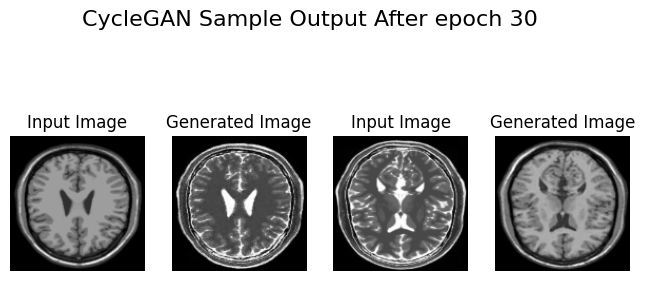

86/86 [==============================] - 31s 357ms/step - G_loss: 1.2883 - F_loss: 1.0604 - D_X_loss: 0.6965 - D_Y_loss: 0.6944 - Total_Generator_Loss: 2.3488
Epoch 31/100
1/1 [==============================] - 0s 30ms/step


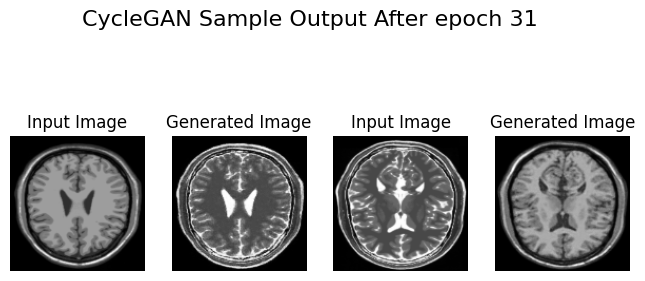

86/86 [==============================] - 31s 357ms/step - G_loss: 1.2765 - F_loss: 1.0659 - D_X_loss: 0.6959 - D_Y_loss: 0.6861 - Total_Generator_Loss: 2.3425
Epoch 32/100
1/1 [==============================] - 0s 28ms/step


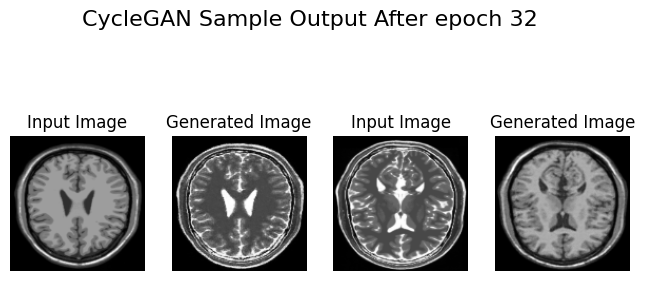

86/86 [==============================] - 31s 355ms/step - G_loss: 1.2820 - F_loss: 1.0683 - D_X_loss: 0.6939 - D_Y_loss: 0.6977 - Total_Generator_Loss: 2.3503
Epoch 33/100
1/1 [==============================] - 0s 33ms/step


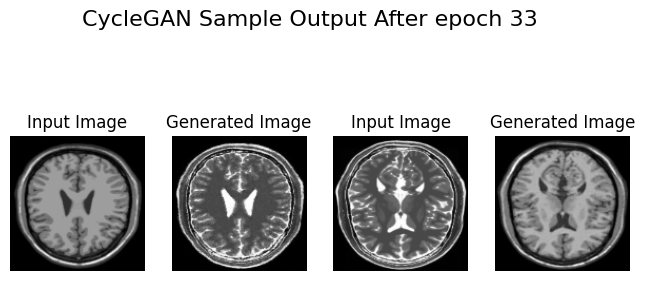

86/86 [==============================] - 31s 356ms/step - G_loss: 1.2446 - F_loss: 1.0302 - D_X_loss: 0.6913 - D_Y_loss: 0.6901 - Total_Generator_Loss: 2.2748
Epoch 34/100
1/1 [==============================] - 0s 29ms/step


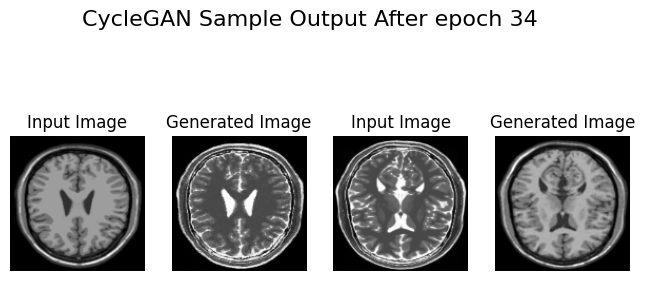

86/86 [==============================] - 31s 357ms/step - G_loss: 1.2345 - F_loss: 1.0356 - D_X_loss: 0.7028 - D_Y_loss: 0.6977 - Total_Generator_Loss: 2.2701
Epoch 35/100
1/1 [==============================] - 0s 66ms/step


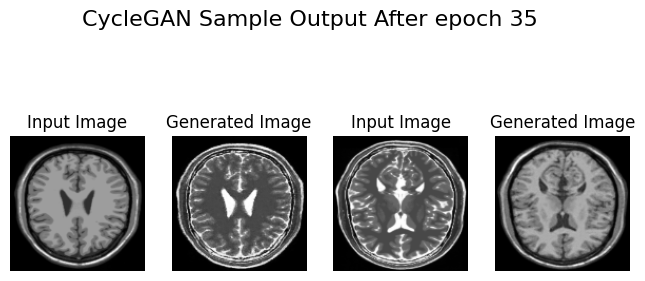

86/86 [==============================] - 31s 361ms/step - G_loss: 1.2057 - F_loss: 1.0223 - D_X_loss: 0.6966 - D_Y_loss: 0.6949 - Total_Generator_Loss: 2.2279
Epoch 36/100
1/1 [==============================] - 0s 30ms/step


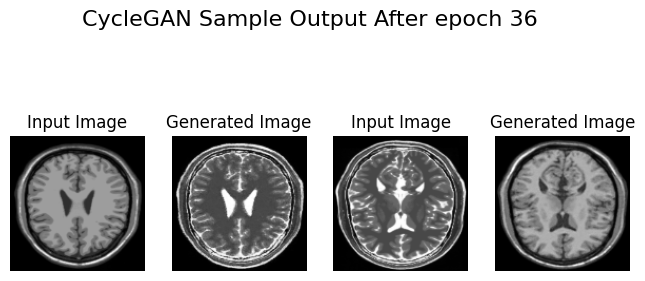

86/86 [==============================] - 31s 359ms/step - G_loss: 1.2157 - F_loss: 1.0337 - D_X_loss: 0.6941 - D_Y_loss: 0.6949 - Total_Generator_Loss: 2.2494
Epoch 37/100
1/1 [==============================] - 0s 26ms/step


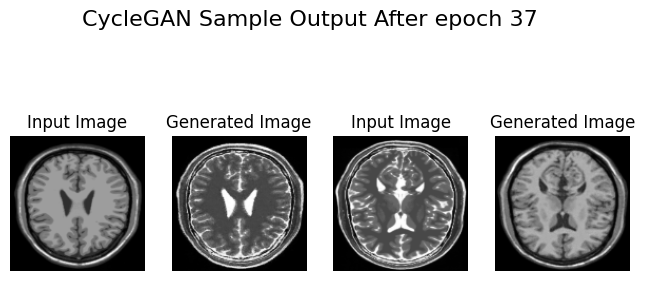

86/86 [==============================] - 31s 356ms/step - G_loss: 1.1579 - F_loss: 0.9975 - D_X_loss: 0.6986 - D_Y_loss: 0.6914 - Total_Generator_Loss: 2.1555
Epoch 38/100
1/1 [==============================] - 0s 33ms/step


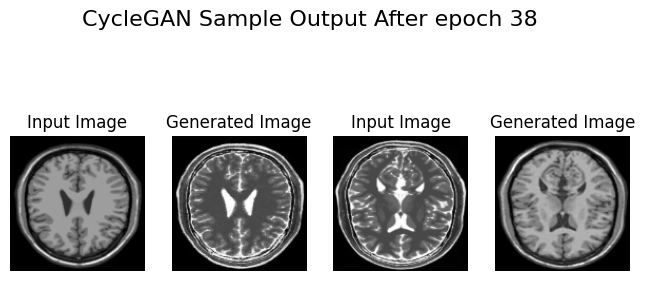

86/86 [==============================] - 31s 357ms/step - G_loss: 1.1806 - F_loss: 1.0104 - D_X_loss: 0.6957 - D_Y_loss: 0.7019 - Total_Generator_Loss: 2.1911
Epoch 39/100
1/1 [==============================] - 0s 30ms/step


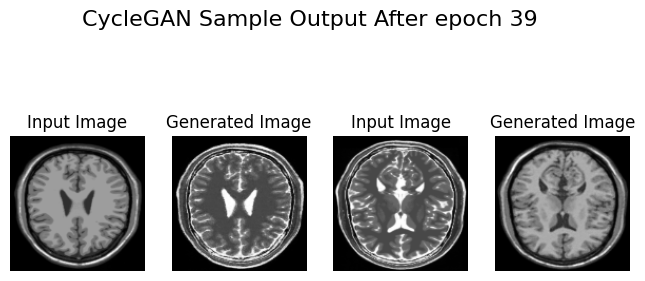

86/86 [==============================] - 31s 356ms/step - G_loss: 1.1645 - F_loss: 1.0075 - D_X_loss: 0.6961 - D_Y_loss: 0.6991 - Total_Generator_Loss: 2.1720
Epoch 40/100
1/1 [==============================] - 0s 48ms/step


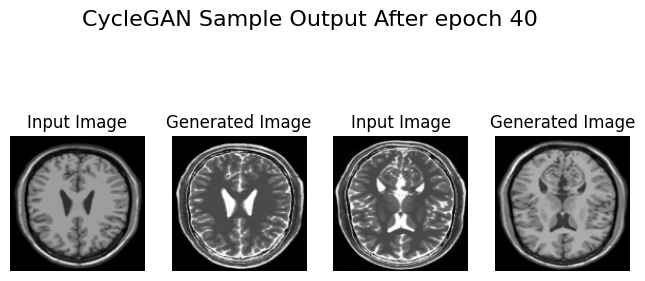

86/86 [==============================] - 31s 360ms/step - G_loss: 1.1495 - F_loss: 0.9949 - D_X_loss: 0.6933 - D_Y_loss: 0.6901 - Total_Generator_Loss: 2.1444
Epoch 41/100
1/1 [==============================] - 0s 29ms/step


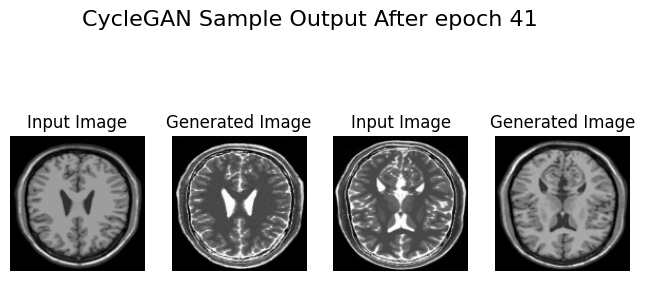

86/86 [==============================] - 31s 358ms/step - G_loss: 1.1638 - F_loss: 1.0170 - D_X_loss: 0.6882 - D_Y_loss: 0.6823 - Total_Generator_Loss: 2.1808
Epoch 42/100
1/1 [==============================] - 0s 29ms/step


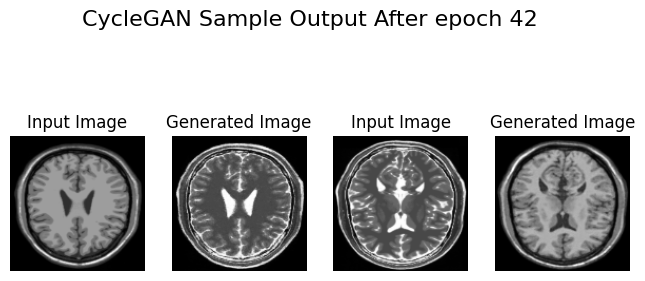

86/86 [==============================] - 31s 357ms/step - G_loss: 1.1628 - F_loss: 0.9978 - D_X_loss: 0.6960 - D_Y_loss: 0.6931 - Total_Generator_Loss: 2.1606
Epoch 43/100
1/1 [==============================] - 0s 30ms/step


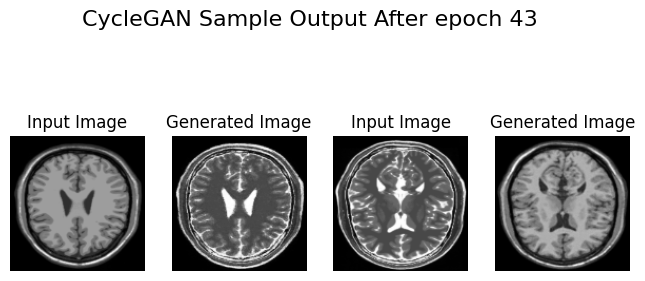

86/86 [==============================] - 31s 355ms/step - G_loss: 1.1277 - F_loss: 1.0040 - D_X_loss: 0.6952 - D_Y_loss: 0.6961 - Total_Generator_Loss: 2.1316
Epoch 44/100
1/1 [==============================] - 0s 27ms/step


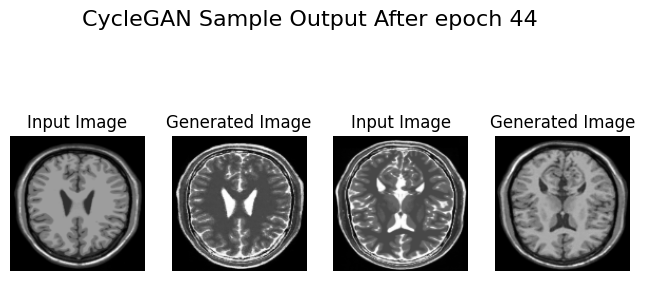

86/86 [==============================] - 31s 361ms/step - G_loss: 1.1473 - F_loss: 0.9937 - D_X_loss: 0.6936 - D_Y_loss: 0.6894 - Total_Generator_Loss: 2.1409
Epoch 45/100
1/1 [==============================] - 0s 29ms/step


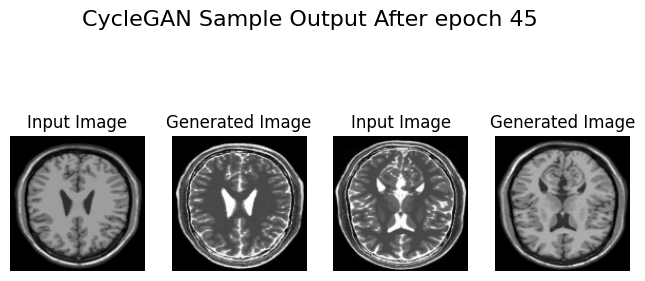

86/86 [==============================] - 30s 354ms/step - G_loss: 1.1354 - F_loss: 0.9933 - D_X_loss: 0.6955 - D_Y_loss: 0.6908 - Total_Generator_Loss: 2.1288
Epoch 46/100
1/1 [==============================] - 0s 32ms/step


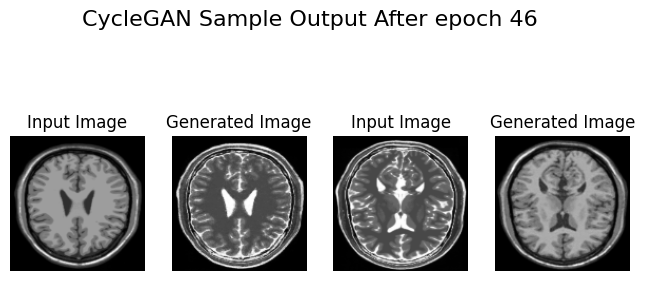

86/86 [==============================] - 31s 354ms/step - G_loss: 1.1308 - F_loss: 0.9962 - D_X_loss: 0.6950 - D_Y_loss: 0.6887 - Total_Generator_Loss: 2.1270
Epoch 47/100
1/1 [==============================] - 0s 31ms/step


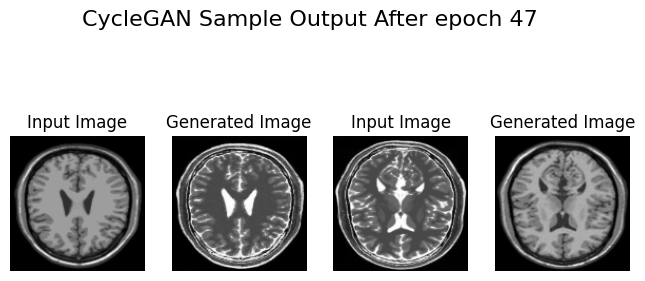

86/86 [==============================] - 31s 355ms/step - G_loss: 1.1135 - F_loss: 0.9758 - D_X_loss: 0.6943 - D_Y_loss: 0.6972 - Total_Generator_Loss: 2.0894
Epoch 48/100
1/1 [==============================] - 0s 31ms/step


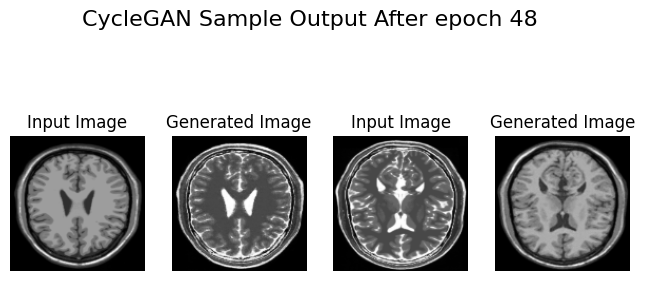

86/86 [==============================] - 31s 359ms/step - G_loss: 1.1218 - F_loss: 0.9894 - D_X_loss: 0.6901 - D_Y_loss: 0.6865 - Total_Generator_Loss: 2.1112
Epoch 49/100
1/1 [==============================] - 0s 48ms/step


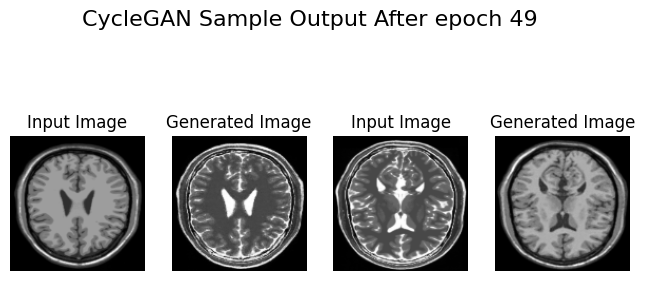

86/86 [==============================] - 31s 361ms/step - G_loss: 1.1167 - F_loss: 0.9740 - D_X_loss: 0.6940 - D_Y_loss: 0.6915 - Total_Generator_Loss: 2.0907
Epoch 50/100
1/1 [==============================] - 0s 35ms/step


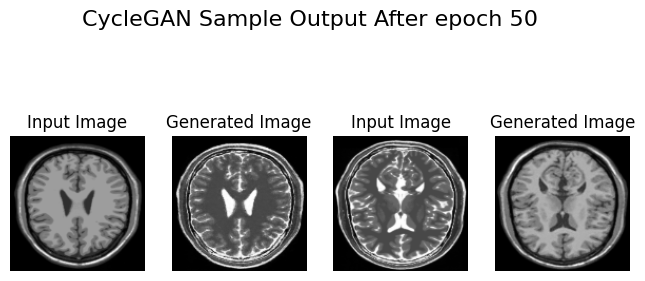

86/86 [==============================] - 31s 360ms/step - G_loss: 1.1252 - F_loss: 0.9905 - D_X_loss: 0.6904 - D_Y_loss: 0.6925 - Total_Generator_Loss: 2.1157
Epoch 51/100
1/1 [==============================] - 0s 48ms/step


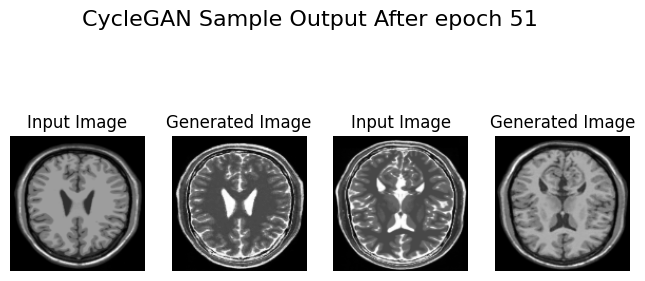

86/86 [==============================] - 31s 363ms/step - G_loss: 1.0846 - F_loss: 0.9579 - D_X_loss: 0.6984 - D_Y_loss: 0.6941 - Total_Generator_Loss: 2.0425
Epoch 52/100
1/1 [==============================] - 0s 26ms/step


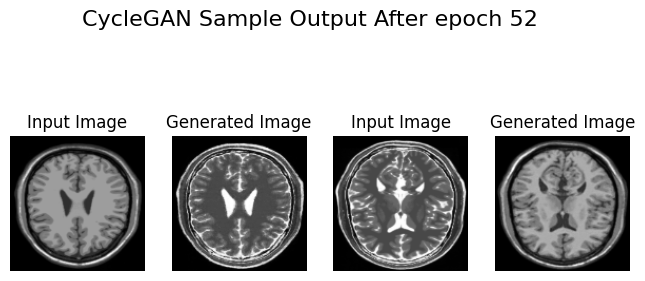

86/86 [==============================] - 31s 361ms/step - G_loss: 1.0810 - F_loss: 0.9580 - D_X_loss: 0.6890 - D_Y_loss: 0.6890 - Total_Generator_Loss: 2.0390
Epoch 53/100
1/1 [==============================] - 0s 27ms/step


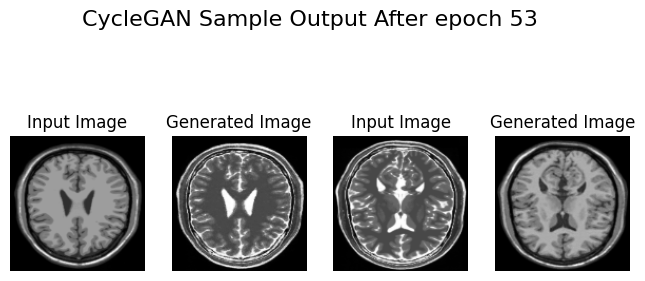

86/86 [==============================] - 31s 358ms/step - G_loss: 1.0899 - F_loss: 0.9678 - D_X_loss: 0.6925 - D_Y_loss: 0.6897 - Total_Generator_Loss: 2.0578
Epoch 54/100
1/1 [==============================] - 0s 35ms/step


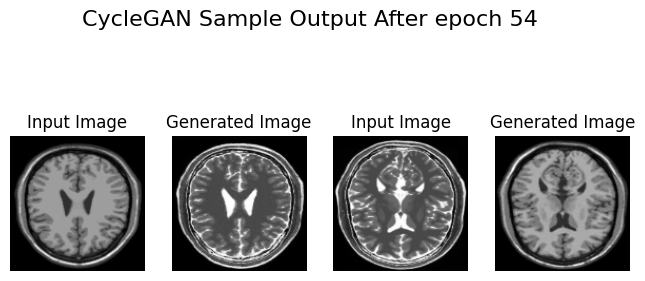

86/86 [==============================] - 31s 359ms/step - G_loss: 1.0808 - F_loss: 0.9614 - D_X_loss: 0.6947 - D_Y_loss: 0.6961 - Total_Generator_Loss: 2.0422
Epoch 55/100
1/1 [==============================] - 0s 28ms/step


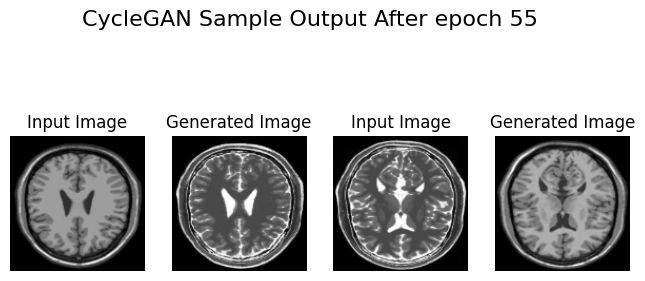

86/86 [==============================] - 31s 363ms/step - G_loss: 1.0812 - F_loss: 0.9643 - D_X_loss: 0.6942 - D_Y_loss: 0.6908 - Total_Generator_Loss: 2.0455
Epoch 56/100
1/1 [==============================] - 0s 40ms/step


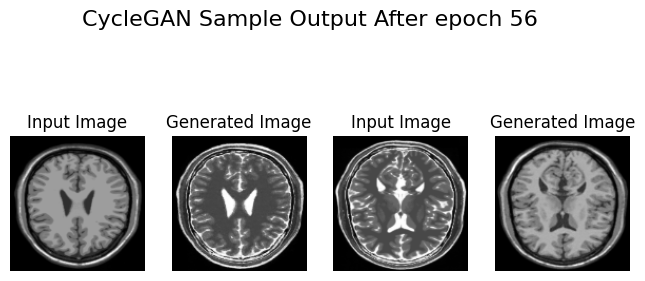

86/86 [==============================] - 31s 360ms/step - G_loss: 1.0807 - F_loss: 0.9567 - D_X_loss: 0.6901 - D_Y_loss: 0.6868 - Total_Generator_Loss: 2.0374
Epoch 57/100
1/1 [==============================] - 0s 33ms/step


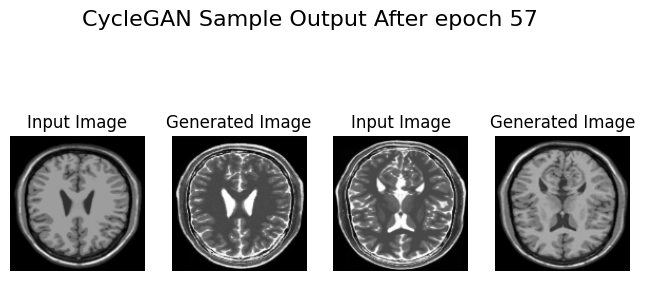

86/86 [==============================] - 31s 359ms/step - G_loss: 1.0684 - F_loss: 0.9556 - D_X_loss: 0.6890 - D_Y_loss: 0.6875 - Total_Generator_Loss: 2.0240
Epoch 58/100
1/1 [==============================] - 0s 60ms/step


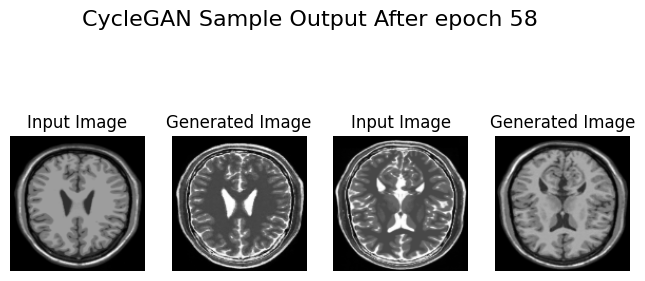

86/86 [==============================] - 31s 360ms/step - G_loss: 1.0701 - F_loss: 0.9530 - D_X_loss: 0.6939 - D_Y_loss: 0.6938 - Total_Generator_Loss: 2.0231
Epoch 59/100
1/1 [==============================] - 0s 29ms/step


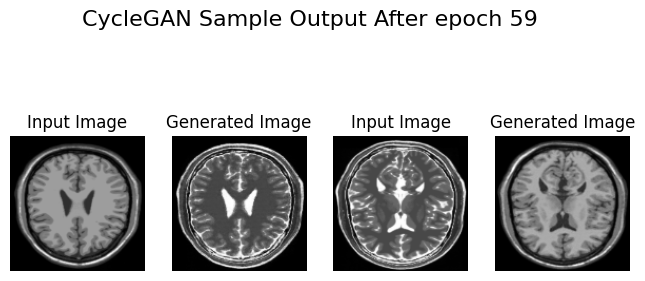

86/86 [==============================] - 31s 358ms/step - G_loss: 1.0719 - F_loss: 0.9619 - D_X_loss: 0.6917 - D_Y_loss: 0.6897 - Total_Generator_Loss: 2.0338
Epoch 60/100
1/1 [==============================] - 0s 28ms/step


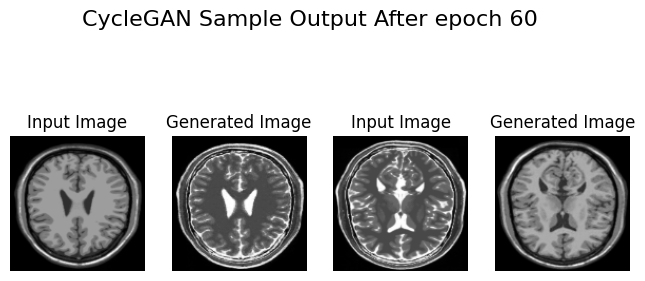

86/86 [==============================] - 31s 359ms/step - G_loss: 1.0665 - F_loss: 0.9514 - D_X_loss: 0.6892 - D_Y_loss: 0.6900 - Total_Generator_Loss: 2.0179
Epoch 61/100
1/1 [==============================] - 0s 50ms/step


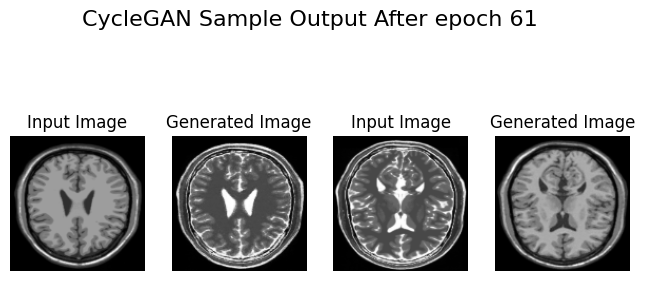

86/86 [==============================] - 31s 361ms/step - G_loss: 1.0736 - F_loss: 0.9604 - D_X_loss: 0.6930 - D_Y_loss: 0.6923 - Total_Generator_Loss: 2.0340
Epoch 62/100
1/1 [==============================] - 0s 28ms/step


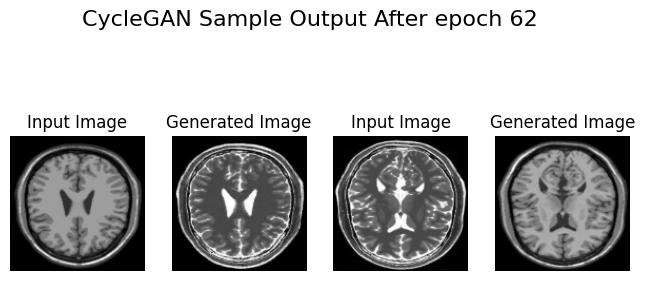

86/86 [==============================] - 31s 361ms/step - G_loss: 1.0661 - F_loss: 0.9509 - D_X_loss: 0.6943 - D_Y_loss: 0.6953 - Total_Generator_Loss: 2.0170
Epoch 63/100
1/1 [==============================] - 0s 28ms/step


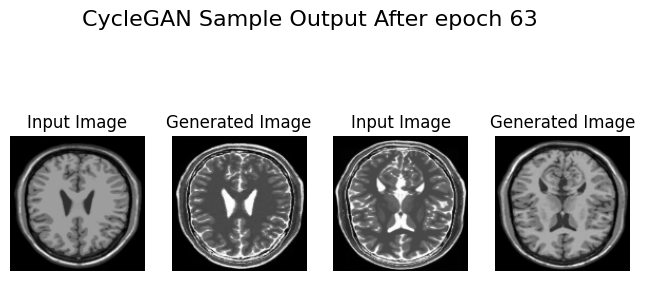

86/86 [==============================] - 31s 358ms/step - G_loss: 1.0460 - F_loss: 0.9316 - D_X_loss: 0.6916 - D_Y_loss: 0.6887 - Total_Generator_Loss: 1.9777
Epoch 64/100
1/1 [==============================] - 0s 26ms/step


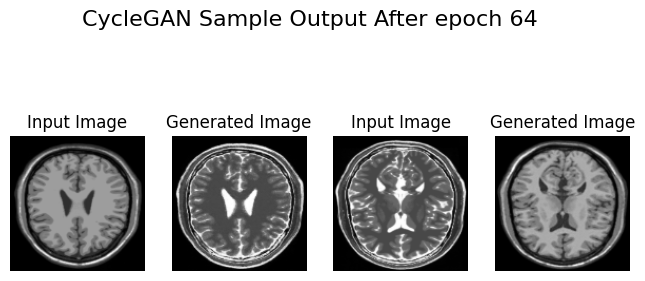

86/86 [==============================] - 31s 357ms/step - G_loss: 1.0435 - F_loss: 0.9430 - D_X_loss: 0.6913 - D_Y_loss: 0.6942 - Total_Generator_Loss: 1.9864
Epoch 65/100
1/1 [==============================] - 0s 29ms/step


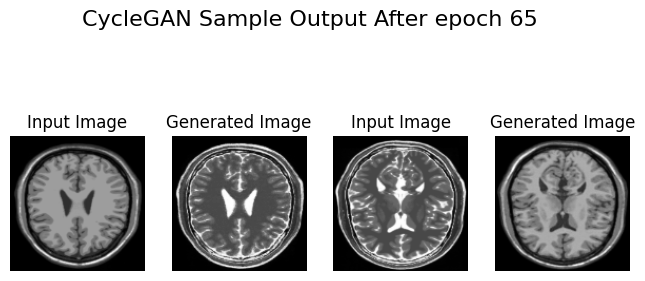

86/86 [==============================] - 31s 356ms/step - G_loss: 1.0383 - F_loss: 0.9240 - D_X_loss: 0.6964 - D_Y_loss: 0.6916 - Total_Generator_Loss: 1.9623
Epoch 66/100
1/1 [==============================] - 0s 42ms/step


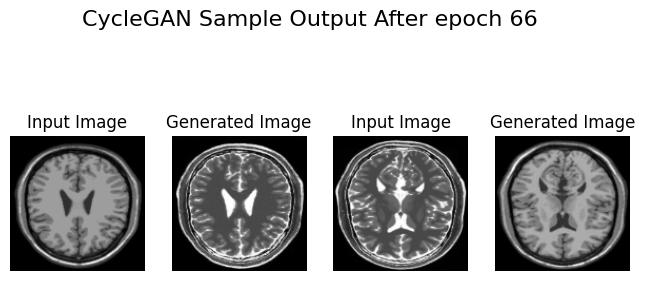

86/86 [==============================] - 31s 358ms/step - G_loss: 1.0277 - F_loss: 0.9271 - D_X_loss: 0.6915 - D_Y_loss: 0.6903 - Total_Generator_Loss: 1.9548
Epoch 67/100
1/1 [==============================] - 0s 27ms/step


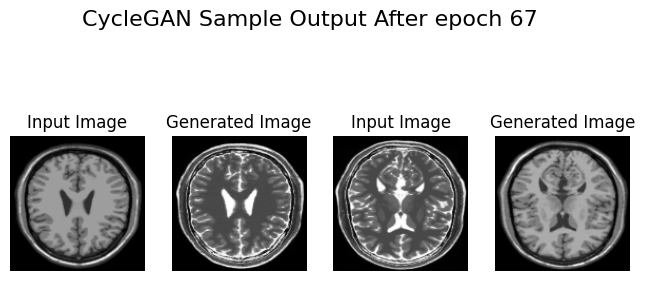

86/86 [==============================] - 31s 361ms/step - G_loss: 1.0449 - F_loss: 0.9408 - D_X_loss: 0.6932 - D_Y_loss: 0.6959 - Total_Generator_Loss: 1.9857
Epoch 68/100
1/1 [==============================] - 0s 40ms/step


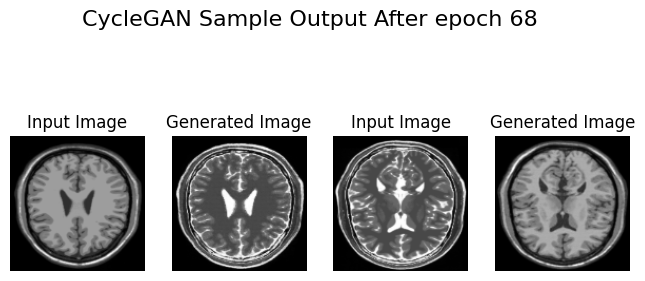

86/86 [==============================] - 31s 357ms/step - G_loss: 1.0370 - F_loss: 0.9356 - D_X_loss: 0.6922 - D_Y_loss: 0.6891 - Total_Generator_Loss: 1.9726
Epoch 69/100
1/1 [==============================] - 0s 50ms/step


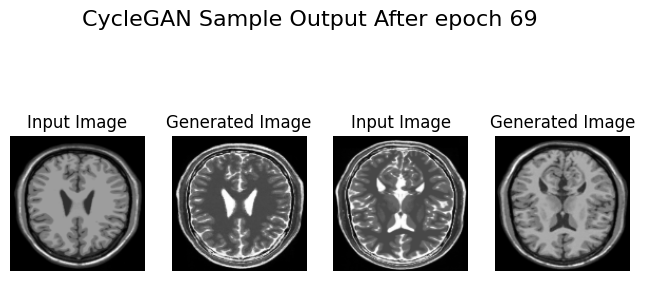

86/86 [==============================] - 31s 360ms/step - G_loss: 1.0340 - F_loss: 0.9339 - D_X_loss: 0.6945 - D_Y_loss: 0.6913 - Total_Generator_Loss: 1.9679
Epoch 70/100
1/1 [==============================] - 0s 28ms/step


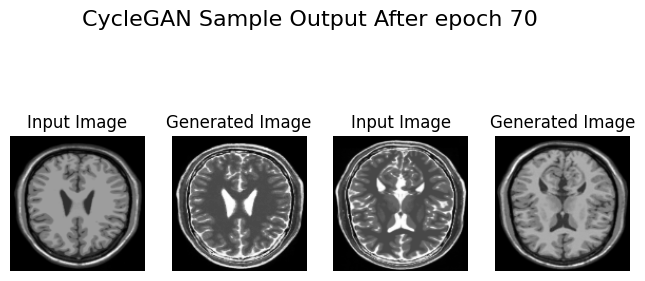

86/86 [==============================] - 31s 359ms/step - G_loss: 1.0228 - F_loss: 0.9300 - D_X_loss: 0.6941 - D_Y_loss: 0.6934 - Total_Generator_Loss: 1.9528
Epoch 71/100
1/1 [==============================] - 0s 29ms/step


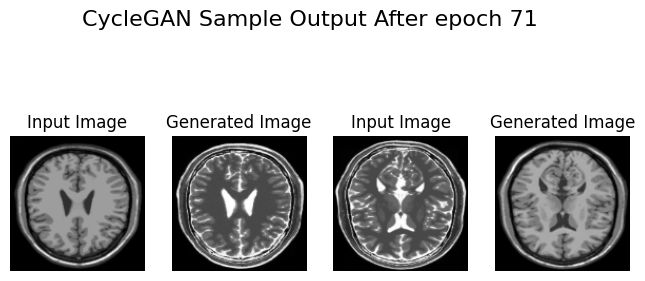

86/86 [==============================] - 31s 356ms/step - G_loss: 1.0229 - F_loss: 0.9231 - D_X_loss: 0.6935 - D_Y_loss: 0.6895 - Total_Generator_Loss: 1.9459
Epoch 72/100
1/1 [==============================] - 0s 29ms/step


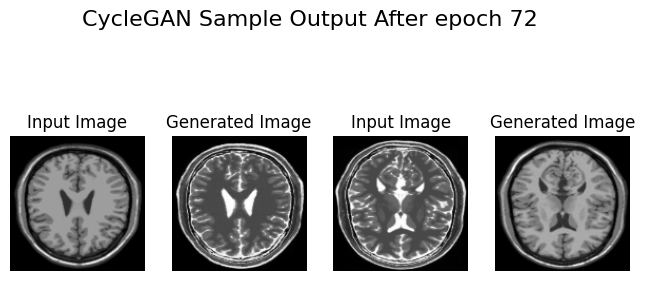

86/86 [==============================] - 31s 357ms/step - G_loss: 1.0275 - F_loss: 0.9194 - D_X_loss: 0.6909 - D_Y_loss: 0.6895 - Total_Generator_Loss: 1.9470
Epoch 73/100
1/1 [==============================] - 0s 32ms/step


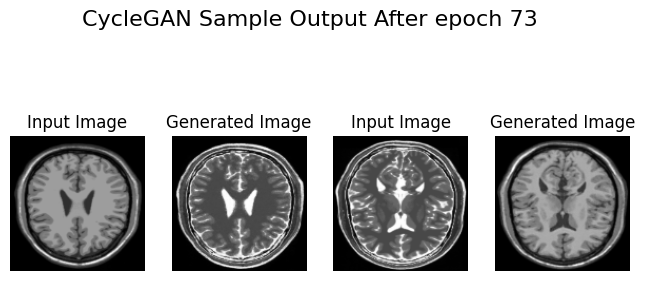

86/86 [==============================] - 31s 356ms/step - G_loss: 1.0529 - F_loss: 0.9273 - D_X_loss: 0.6938 - D_Y_loss: 0.6912 - Total_Generator_Loss: 1.9802
Epoch 74/100
1/1 [==============================] - 0s 33ms/step


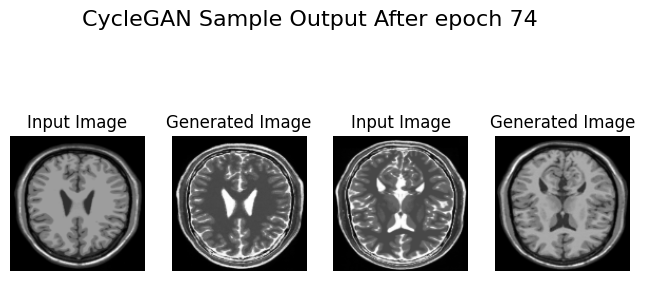

86/86 [==============================] - 31s 355ms/step - G_loss: 1.0142 - F_loss: 0.9109 - D_X_loss: 0.6952 - D_Y_loss: 0.6926 - Total_Generator_Loss: 1.9251
Epoch 75/100
1/1 [==============================] - 0s 44ms/step


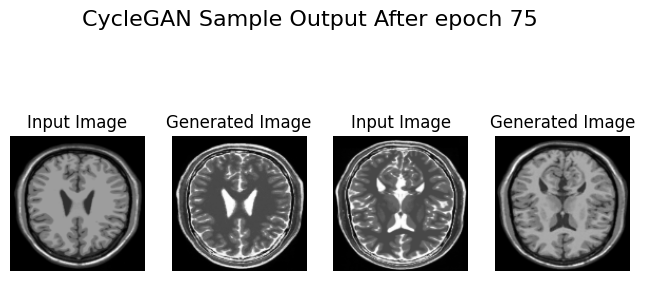

86/86 [==============================] - 31s 357ms/step - G_loss: 1.0153 - F_loss: 0.9209 - D_X_loss: 0.6953 - D_Y_loss: 0.6916 - Total_Generator_Loss: 1.9361
Epoch 76/100
1/1 [==============================] - 0s 27ms/step


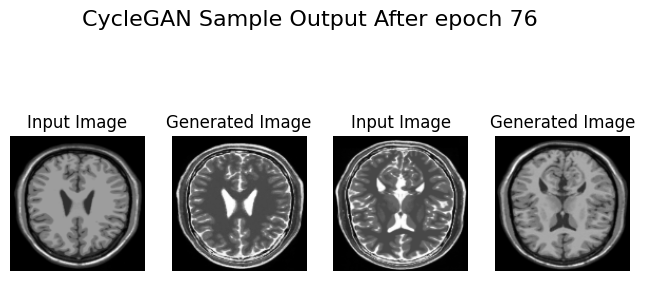

86/86 [==============================] - 31s 359ms/step - G_loss: 0.9760 - F_loss: 0.9104 - D_X_loss: 0.6902 - D_Y_loss: 0.6987 - Total_Generator_Loss: 1.8864
Epoch 77/100
1/1 [==============================] - 0s 33ms/step


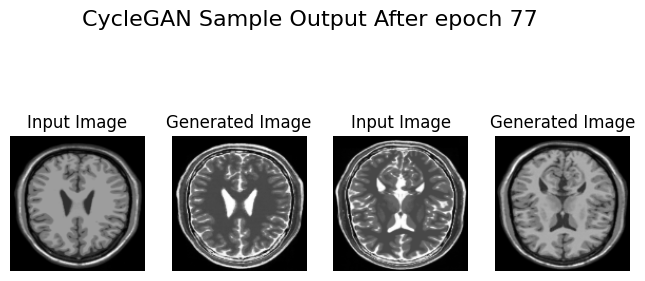

86/86 [==============================] - 31s 358ms/step - G_loss: 0.9778 - F_loss: 0.9185 - D_X_loss: 0.6948 - D_Y_loss: 0.6981 - Total_Generator_Loss: 1.8963
Epoch 78/100
1/1 [==============================] - 0s 28ms/step


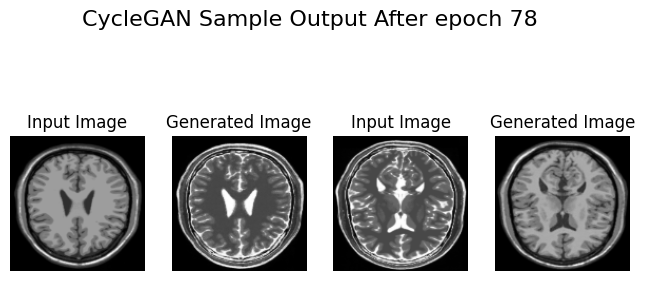

86/86 [==============================] - 31s 356ms/step - G_loss: 0.9831 - F_loss: 0.9132 - D_X_loss: 0.6927 - D_Y_loss: 0.6939 - Total_Generator_Loss: 1.8963
Epoch 79/100
1/1 [==============================] - 0s 31ms/step


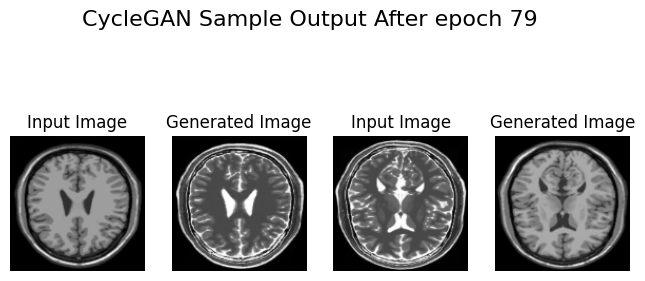

86/86 [==============================] - 31s 357ms/step - G_loss: 0.9977 - F_loss: 0.9111 - D_X_loss: 0.6973 - D_Y_loss: 0.6994 - Total_Generator_Loss: 1.9088
Epoch 80/100
1/1 [==============================] - 0s 27ms/step


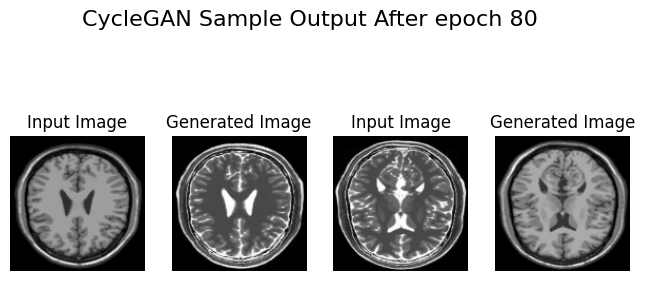

86/86 [==============================] - 31s 359ms/step - G_loss: 1.0088 - F_loss: 0.9056 - D_X_loss: 0.6914 - D_Y_loss: 0.6903 - Total_Generator_Loss: 1.9144
Epoch 81/100
1/1 [==============================] - 0s 28ms/step


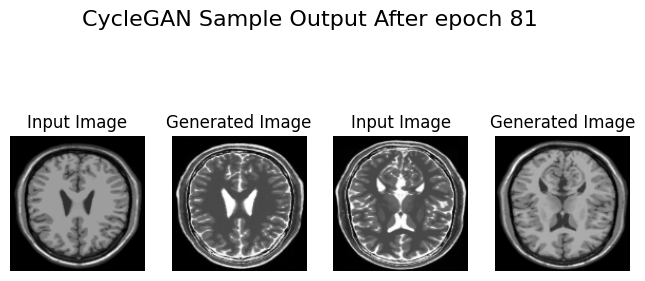

86/86 [==============================] - 31s 362ms/step - G_loss: 1.0059 - F_loss: 0.9087 - D_X_loss: 0.6920 - D_Y_loss: 0.6937 - Total_Generator_Loss: 1.9145
Epoch 82/100
1/1 [==============================] - 0s 37ms/step


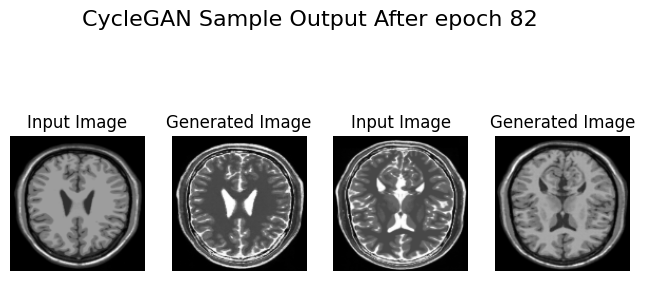

86/86 [==============================] - 31s 359ms/step - G_loss: 1.0021 - F_loss: 0.9136 - D_X_loss: 0.6896 - D_Y_loss: 0.6894 - Total_Generator_Loss: 1.9157
Epoch 83/100
1/1 [==============================] - 0s 47ms/step


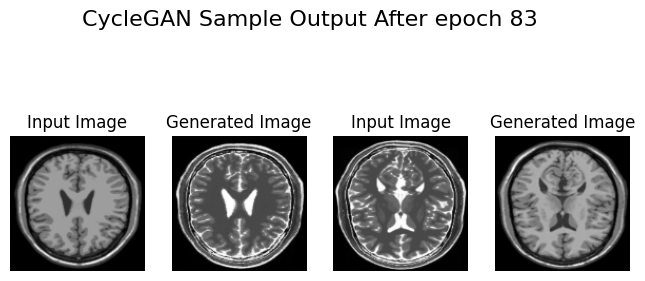

86/86 [==============================] - 31s 358ms/step - G_loss: 1.0173 - F_loss: 0.9246 - D_X_loss: 0.6904 - D_Y_loss: 0.6937 - Total_Generator_Loss: 1.9419
Epoch 84/100
1/1 [==============================] - 0s 40ms/step


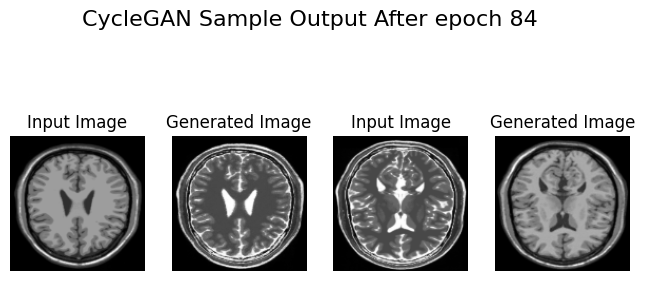

86/86 [==============================] - 31s 358ms/step - G_loss: 0.9809 - F_loss: 0.8882 - D_X_loss: 0.6960 - D_Y_loss: 0.6931 - Total_Generator_Loss: 1.8691
Epoch 85/100
1/1 [==============================] - 0s 34ms/step


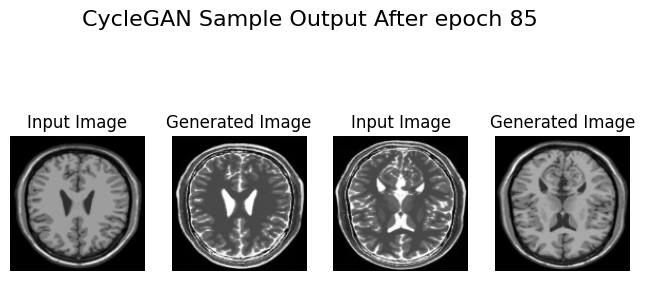

86/86 [==============================] - 31s 357ms/step - G_loss: 0.9982 - F_loss: 0.8930 - D_X_loss: 0.6935 - D_Y_loss: 0.6921 - Total_Generator_Loss: 1.8912
Epoch 86/100
1/1 [==============================] - 0s 27ms/step


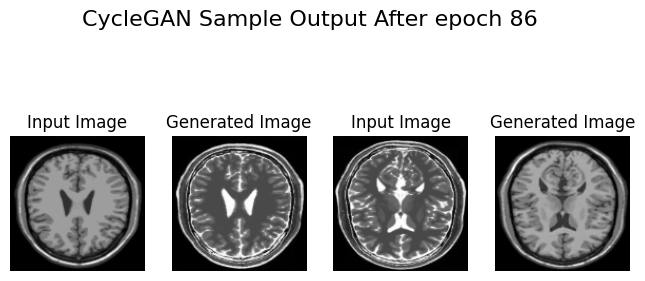

86/86 [==============================] - 31s 360ms/step - G_loss: 0.9870 - F_loss: 0.9020 - D_X_loss: 0.6923 - D_Y_loss: 0.6945 - Total_Generator_Loss: 1.8890
Epoch 87/100
1/1 [==============================] - 0s 29ms/step


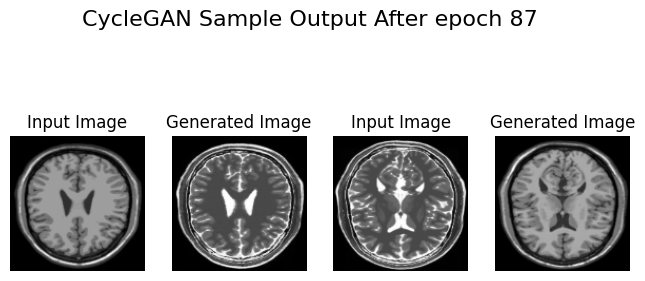

86/86 [==============================] - 31s 357ms/step - G_loss: 0.9940 - F_loss: 0.9064 - D_X_loss: 0.6920 - D_Y_loss: 0.6917 - Total_Generator_Loss: 1.9004
Epoch 88/100
1/1 [==============================] - 0s 32ms/step


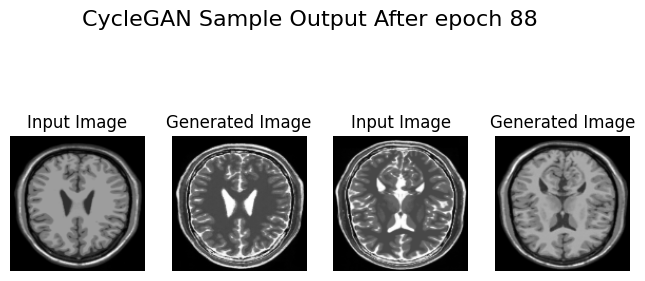

86/86 [==============================] - 31s 356ms/step - G_loss: 0.9878 - F_loss: 0.9018 - D_X_loss: 0.6901 - D_Y_loss: 0.6902 - Total_Generator_Loss: 1.8895
Epoch 89/100
1/1 [==============================] - 0s 31ms/step


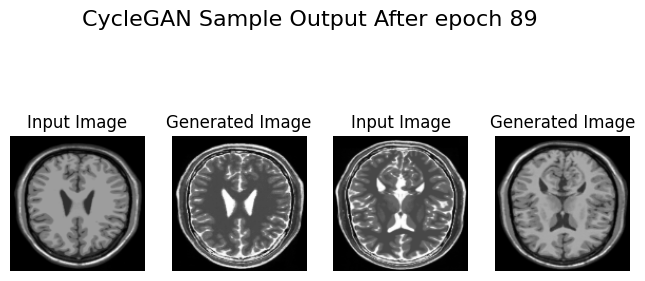

86/86 [==============================] - 31s 363ms/step - G_loss: 0.9897 - F_loss: 0.9003 - D_X_loss: 0.6891 - D_Y_loss: 0.6882 - Total_Generator_Loss: 1.8900
Epoch 90/100
1/1 [==============================] - 0s 37ms/step


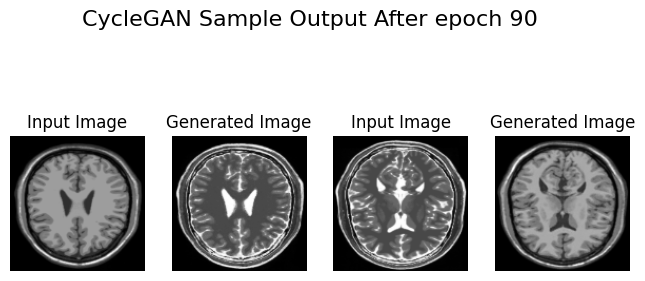

86/86 [==============================] - 31s 357ms/step - G_loss: 0.9941 - F_loss: 0.9001 - D_X_loss: 0.6948 - D_Y_loss: 0.6942 - Total_Generator_Loss: 1.8942
Epoch 91/100
1/1 [==============================] - 0s 61ms/step


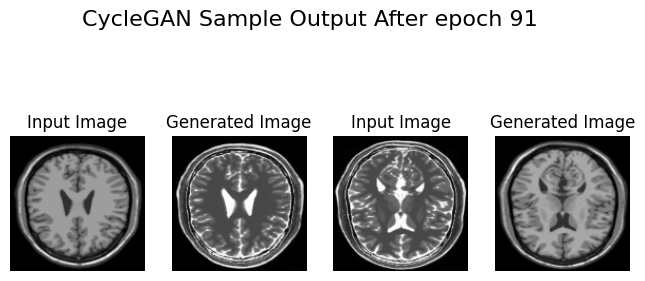

86/86 [==============================] - 31s 360ms/step - G_loss: 0.9816 - F_loss: 0.8982 - D_X_loss: 0.6922 - D_Y_loss: 0.6926 - Total_Generator_Loss: 1.8798
Epoch 92/100
1/1 [==============================] - 0s 29ms/step


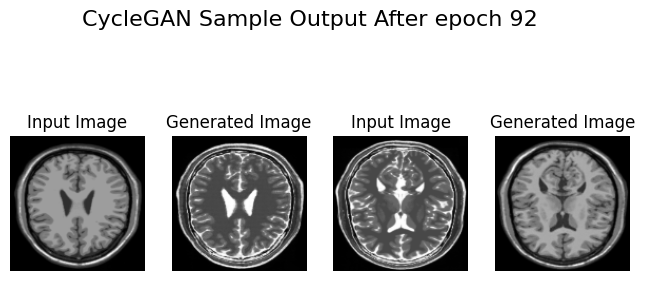

86/86 [==============================] - 31s 359ms/step - G_loss: 0.9723 - F_loss: 0.8945 - D_X_loss: 0.6902 - D_Y_loss: 0.6893 - Total_Generator_Loss: 1.8668
Epoch 93/100
1/1 [==============================] - 0s 29ms/step


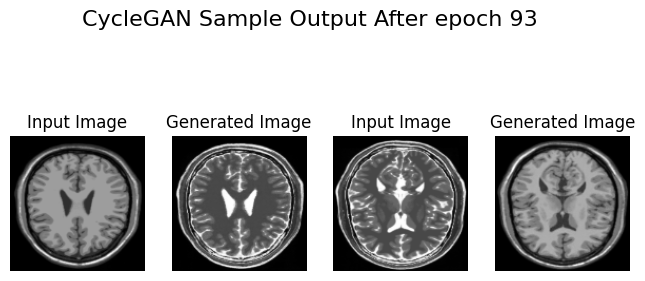

86/86 [==============================] - 31s 357ms/step - G_loss: 0.9946 - F_loss: 0.8976 - D_X_loss: 0.6944 - D_Y_loss: 0.6928 - Total_Generator_Loss: 1.8922
Epoch 94/100
1/1 [==============================] - 0s 62ms/step


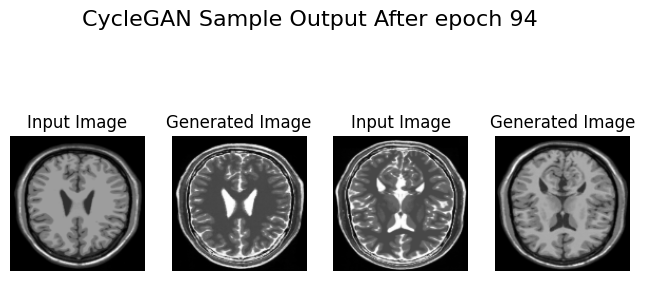

86/86 [==============================] - 31s 361ms/step - G_loss: 0.9683 - F_loss: 0.8896 - D_X_loss: 0.6901 - D_Y_loss: 0.6900 - Total_Generator_Loss: 1.8579
Epoch 95/100
1/1 [==============================] - 0s 29ms/step


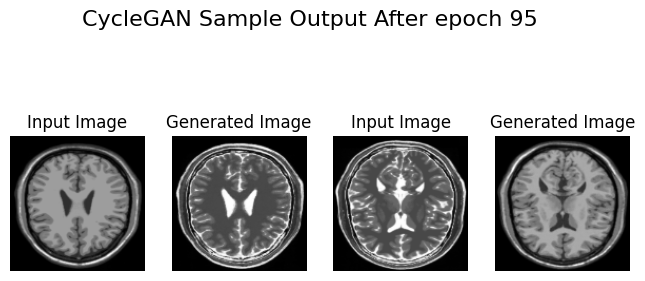

86/86 [==============================] - 31s 359ms/step - G_loss: 0.9805 - F_loss: 0.8905 - D_X_loss: 0.6932 - D_Y_loss: 0.6936 - Total_Generator_Loss: 1.8710
Epoch 96/100
1/1 [==============================] - 0s 30ms/step


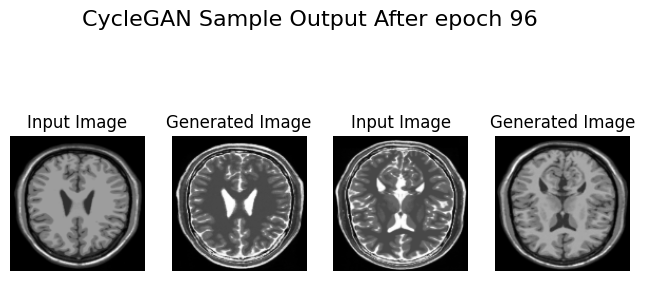

86/86 [==============================] - 31s 357ms/step - G_loss: 0.9749 - F_loss: 0.8863 - D_X_loss: 0.6925 - D_Y_loss: 0.6894 - Total_Generator_Loss: 1.8613
Epoch 97/100
1/1 [==============================] - 0s 30ms/step


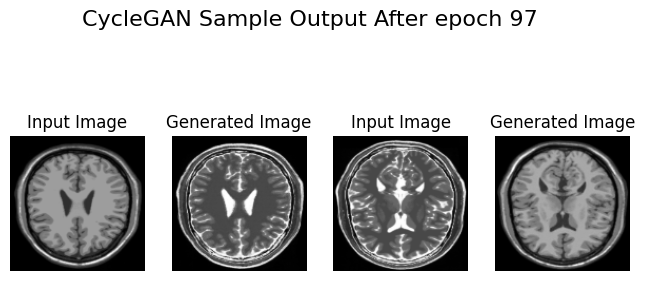

86/86 [==============================] - 31s 357ms/step - G_loss: 0.9612 - F_loss: 0.8885 - D_X_loss: 0.6914 - D_Y_loss: 0.6940 - Total_Generator_Loss: 1.8496
Epoch 98/100
1/1 [==============================] - 0s 27ms/step


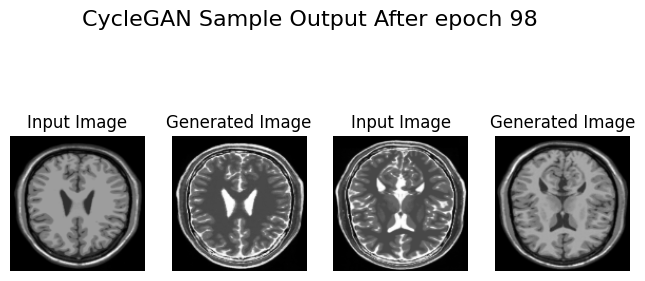

86/86 [==============================] - 31s 361ms/step - G_loss: 0.9704 - F_loss: 0.8890 - D_X_loss: 0.6892 - D_Y_loss: 0.6901 - Total_Generator_Loss: 1.8594
Epoch 99/100
1/1 [==============================] - 0s 28ms/step


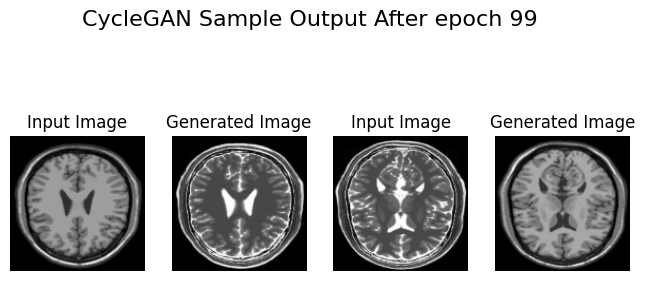

86/86 [==============================] - 31s 361ms/step - G_loss: 0.9604 - F_loss: 0.8882 - D_X_loss: 0.6914 - D_Y_loss: 0.6914 - Total_Generator_Loss: 1.8486
Epoch 100/100
1/1 [==============================] - 0s 28ms/step


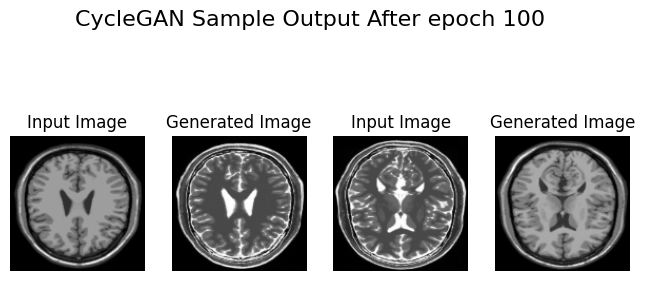

86/86 [==============================] - 31s 361ms/step - G_loss: 0.9644 - F_loss: 0.8961 - D_X_loss: 0.6904 - D_Y_loss: 0.6908 - Total_Generator_Loss: 1.8605


In [98]:
# Fit the model
history = cycle_gan_model.fit(
    tf.data.Dataset.zip((t1_images, t2_images)),
    epochs=epochs,
    callbacks=[plotter],
)

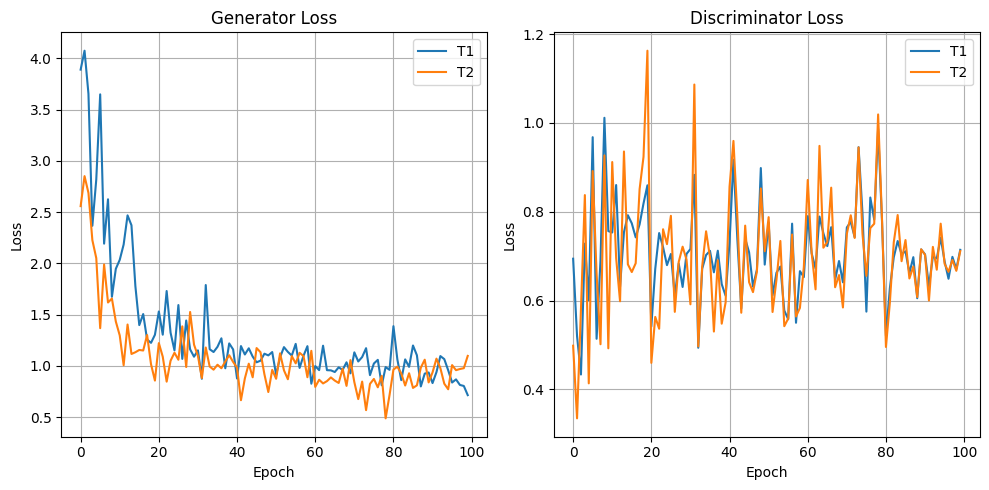

In [99]:
def plot_hist(hist):
    plt.figure(figsize=(10, 5))
    plt.subplot(121)
    plt.plot(hist.history["G_loss"])
    plt.plot(hist.history["F_loss"])
    plt.legend(["T1", "T2"])
    plt.title("Generator Loss")
    plt.ylabel("Loss")
    plt.xlabel("Epoch")
    plt.grid()
    plt.subplot(122)
    plt.plot(hist.history["D_X_loss"])
    plt.plot(hist.history["D_Y_loss"])
    plt.title("Discriminator Loss")
    plt.ylabel("Loss")
    plt.xlabel("Epoch")
    plt.grid()
    plt.legend(["T1", "T2"])
    plt.tight_layout()
    plt.show()


plot_hist(history)

### Checking the output of the model

In [100]:
anim_file = "cyclegan_mri_pre.gif"
pro_img_path = "./IMG/"
filenames = [pro_img_path + i for i in os.listdir(pro_img_path)]
filenames = sorted(filenames, key=os.path.getmtime)
img_list = [imageio.imread(filename) for filename in filenames]
imageio.mimsave(anim_file, img_list, duration=2, loop=1)


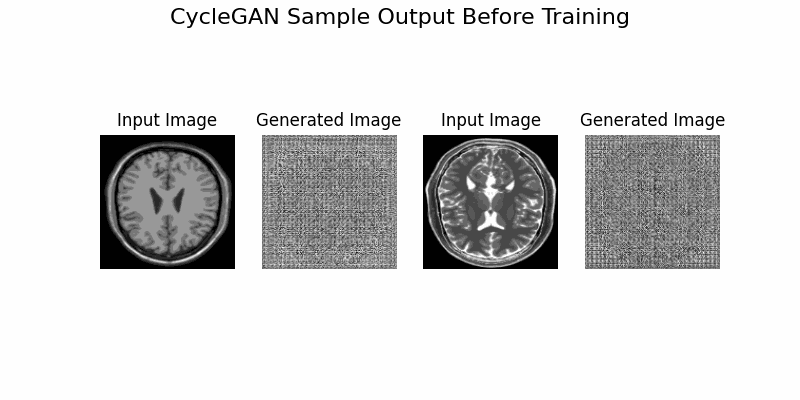

In [104]:
import tensorflow_docs.vis.embed as embed

embed.embed_file(anim_file)

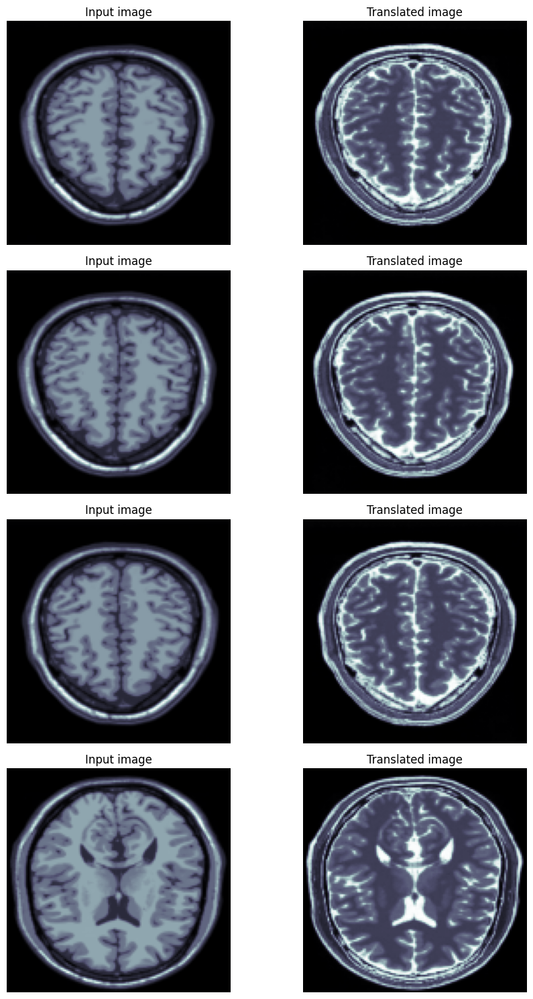

In [105]:
# evaluate the model for T1 to T2
_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(t1_images.take(4)):
    prediction = cycle_gan_model.gen_G(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img, cmap="bone")
    ax[i, 1].imshow(prediction, cmap="bone")
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = tf.keras.utils.array_to_img(prediction)
plt.tight_layout()
plt.show()

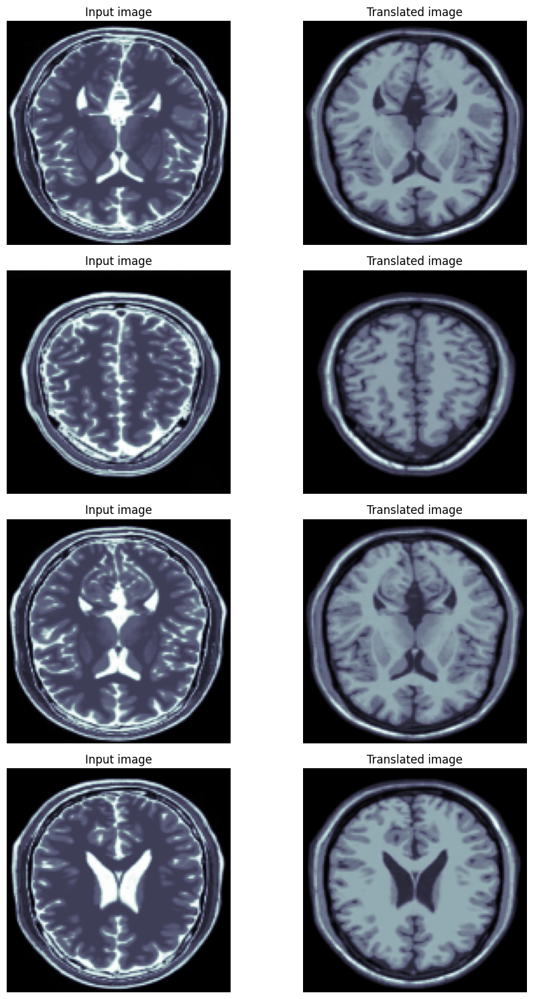

In [106]:
# evaluate the model for T2 to T1
_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(t2_images.take(4)):
    prediction = cycle_gan_model.gen_F(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img, cmap="bone")
    ax[i, 1].imshow(prediction, cmap="bone")
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = tf.keras.utils.array_to_img(prediction)
plt.tight_layout()
plt.show()